# ***Proyecto de Consolidación 3***

## ***Equipo 1***

- *Pablo López Galvez*
- *Lidia López Olmeda*
- *Javier Domingo Serrano*
- *Eduardo Fernández García*

In [97]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
import networkx as nx
from networkx.algorithms import community
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.neural_network import MLPRegressor
import plotly.express as px
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.neighbors import NearestNeighbors

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import warnings
warnings.filterwarnings('ignore')

## [EJERCICIO 1] Aplicación de citas. ¿Quiénes serán los siguientes pretendientes?

Una aplicación de citas nos ha solicitado que desarrollemos un sistema de recomendación. En él, debemos proponer las cuatro personas que mayor probabilidad tengan de terminar teniendo una cita. Para ello, nos proponen el siguiente conjunto de datos: *datasetCitas.csv*. En él, se pueden ver los números identificadores de usuario, así como características que los describen, tales como: si la persona está soltera, el sexo de la persona, la orientación sexual, si siguen alguna dieta o si beben o fuman, entre otras. 

Para ello debemos:

In [2]:
# Cargamos el dataset
citas = pd.read_csv("datasets/datasetCitas.csv")

### a) Realizar un análisis exploratorio de los datos. ¿Qué información contienen nuestras variables? Propón hipótesis y resuélvelas empleando técnicas de análisis exploratorio de datos (visual y/o estadísticas)

In [3]:
# Primeras filas del dataset
citas.head()

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
0,22,single,m,straight,a little extra,anything,socially,never,75.0,sometimes,20471OC
1,35,single,m,straight,average,other,often,sometimes,70.0,no,90676DD
2,38,available,m,straight,thin,anything,socially,NaN,68.0,no,55184RY
3,23,single,m,straight,thin,vegetarian,socially,NaN,71.0,no,47777YP
4,29,single,m,straight,athletic,NaN,socially,never,66.0,no,56729ZW


In [4]:
# Info de cada columna
citas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59946 entries, 0 to 59945
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          59946 non-null  int64  
 1   status       59946 non-null  object 
 2   sex          59946 non-null  object 
 3   orientation  59946 non-null  object 
 4   body_type    54650 non-null  object 
 5   diet         35551 non-null  object 
 6   drinks       56961 non-null  object 
 7   drugs        45866 non-null  object 
 8   height       59943 non-null  float64
 9   smokes       54434 non-null  object 
 10  user         59946 non-null  object 
dtypes: float64(1), int64(1), object(9)
memory usage: 5.0+ MB


In [5]:
# Número de valores nulos
citas.isna().sum()

age                0
status             0
sex                0
orientation        0
body_type       5296
diet           24395
drinks          2985
drugs          14080
height             3
smokes          5512
user               0
dtype: int64

In [6]:
# Info de las variables numéricas
citas.describe()

,age,height
count,59946.000000,59943.000000
mean,32.340290,68.295281
std,9.452779,3.994803
min,18.000000,1.000000
25%,26.000000,66.000000
50%,30.000000,68.000000
75%,37.000000,71.000000
max,110.000000,95.000000


In [7]:
# Eliminamos la variable 'user' ya que no aporta información
citas_filtered= citas.drop("user", axis = 1)

In [8]:
# One Hot Encoding sobre las columnas restantes
citas_dumm = pd.get_dummies(citas_filtered, dtype=int)

In [9]:
# Número de columnas restantes
len(citas_dumm.columns)

41

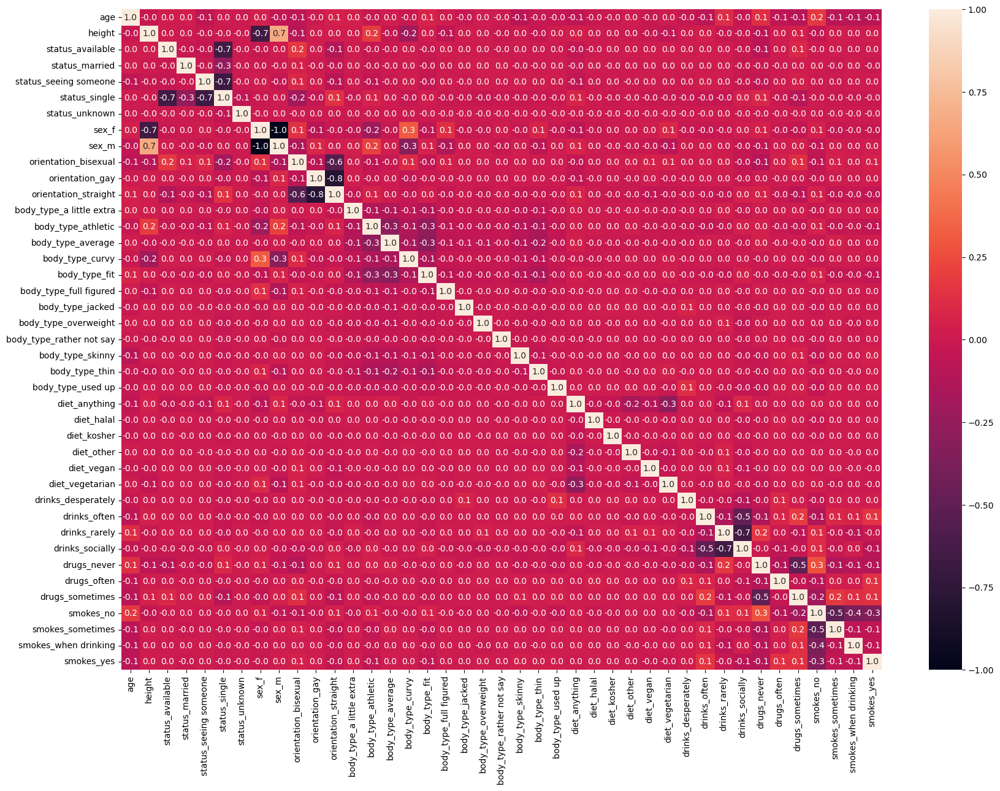

In [10]:
# Matriz de correlación 
correlation_matrix = citas_dumm.corr().round(2)
plt.figure(figsize=(20,14))
#sns.heatmap(data=correlation_matrix, annot=True)
sns.heatmap(correlation_matrix, annot=True, fmt=".1f");

In [11]:
# Filtramos el dataset por hombre/mujer
citas_male = citas[citas["sex"] == "m"]
citas_female = citas[citas["sex"] == "f"]

# Para cada sexo nos quedamos con edad y altura (los usaremos en rep. gráficas)
cols_male = citas_male[["age", "height"]]
cols_female = citas_female[["age", "height"]]

Mean for col age is 32.01858829439839 for men
Standard deviation for col age is 9.032754628453338 for men


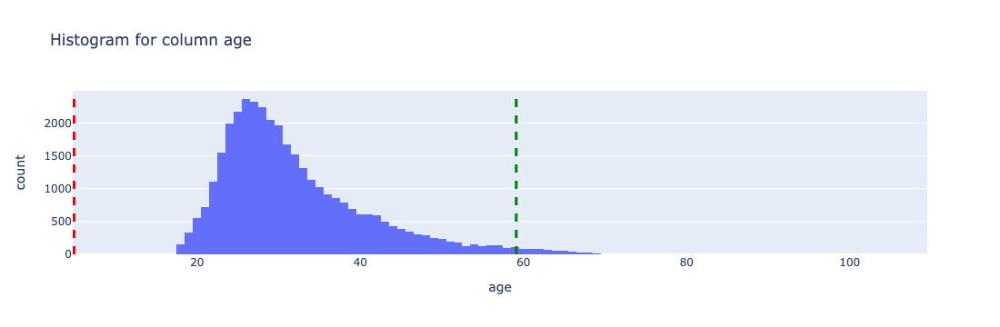

Mean for col height is 70.4434923381807 for men
Standard deviation for col height is 3.0764777206439944 for men


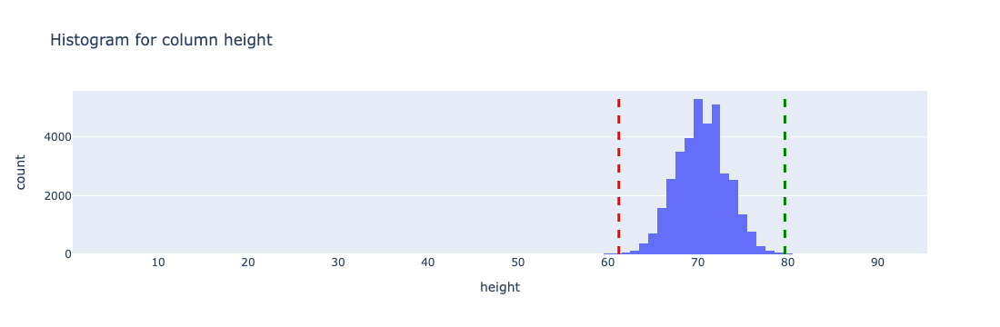

In [12]:
# Rep. gráfica de las columnas anteriores para hombre
for col in cols_male:
    fig = px.histogram(citas_male, x=col, title=f"Histogram for column {col}")
    
    # Comprobación de valores atípicos
    mean = np.mean(citas_male[col])
    std = np.std(citas_male[col])

    print(f"Mean for col {col} is {mean} for men")
    print(f"Standard deviation for col {col} is {std} for men")

    atipicos_graves_sup = mean + 3*std
    atipicos_graves_inf = mean - 3*std

    fig.add_vline(x=atipicos_graves_sup, line_width=3, line_dash="dash", line_color="green")
    fig.add_vline(x=atipicos_graves_inf, line_width=3, line_dash="dash", line_color="red")
    
    fig.show()

Mean for col age is 32.81821951320645 for women
Standard deviation for col age is 10.025176819771655 for women


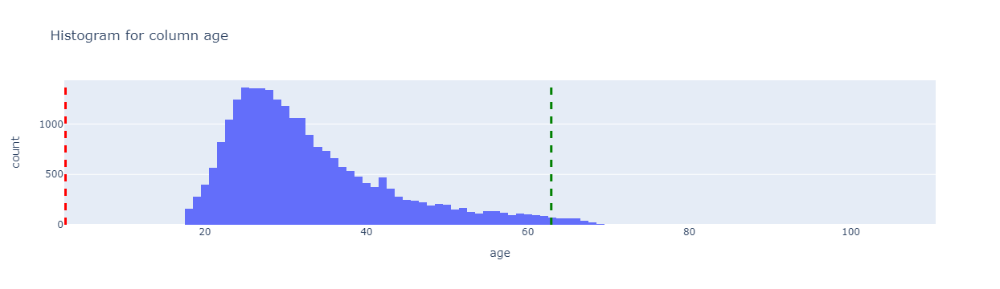

Mean for col height is 65.1038729474208 for women
Standard deviation for col height is 2.9264410101148854 for women


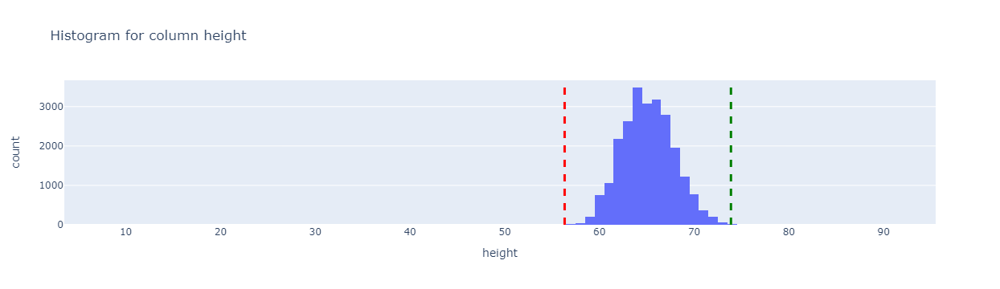

In [13]:
# Rep. gráfica de las columnas anteriores para mujer
for col in cols_female:
    fig = px.histogram(citas_female, x=col, title=f"Histogram for column {col}")
    
    # Comprobación de valores atípicos
    mean = np.mean(citas_female[col])
    std = np.std(citas_female[col])

    print(f"Mean for col {col} is {mean} for women")
    print(f"Standard deviation for col {col} is {std} for women")

    atipicos_graves_sup = mean + 3*std
    atipicos_graves_inf = mean - 3*std

    fig.add_vline(x=atipicos_graves_sup, line_width=3, line_dash="dash", line_color="green")
    fig.add_vline(x=atipicos_graves_inf, line_width=3, line_dash="dash", line_color="red")
    
    fig.show()

In [14]:
# Filtramos la edad para valores mayores a 100 años. La idea es ver si existen datos atípicos
citas_atypical_age = citas[citas["age"] >= 100]
citas_atypical_age

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
2512,110,single,f,straight,NaN,NaN,NaN,NaN,67.0,NaN,12327EJ
25324,109,available,m,straight,athletic,other,NaN,never,95.0,when drinking,52402QQ


In [15]:
# Hombres con peso menor a 60 o mayor a 80
citas_atypical_height_male = citas[(citas["sex"] == 'm') & ((citas["height"] <= 60) | (citas["height"] >= 80))]
citas_atypical_height_male.head()

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
243,29,single,m,straight,fit,other,socially,never,80.0,no,71085VI
280,27,single,m,straight,athletic,anything,rarely,never,80.0,no,66081VV
546,32,single,m,straight,curvy,anything,rarely,sometimes,83.0,when drinking,11509YS
1922,26,single,m,straight,fit,NaN,NaN,never,83.0,NaN,74240QX
2569,26,single,m,straight,NaN,other,NaN,NaN,95.0,NaN,90639ZD


In [16]:
# Mujer con peso menor a 57 o mayor a 75
citas_atypical_height_female = citas[(citas["sex"] == 'f') & ((citas["height"] <= 57) | (citas["height"] >= 75))]
citas_atypical_height_female.head()

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
402,22,single,f,straight,jacked,anything,often,sometimes,91.0,no,81087MD
2020,19,single,f,straight,average,anything,rarely,never,56.0,no,24177AK
2584,44,single,f,straight,a little extra,anything,socially,never,57.0,sometimes,61367TQ
2683,29,single,f,gay,NaN,NaN,socially,sometimes,75.0,sometimes,10516NH
5254,24,single,f,straight,NaN,NaN,rarely,never,56.0,no,66816KF


#### Análisis de todo el dataset

***Equipo 1*** - *A continuación vamos a hacer un análisis de las variables que conforman el dataset. para cada una exploraremos el número de valores distintos que la conforman, de manera visual y numérica.*

##### Número de hombres y mujeres

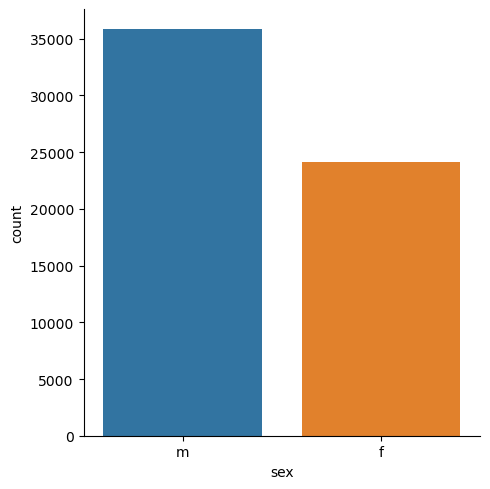

In [17]:
sns.catplot(x= "sex", kind = "count", data = citas);

In [18]:
citas.groupby(['sex']).size()

sex
f    24117
m    35829
dtype: int64

##### Número de personas por status

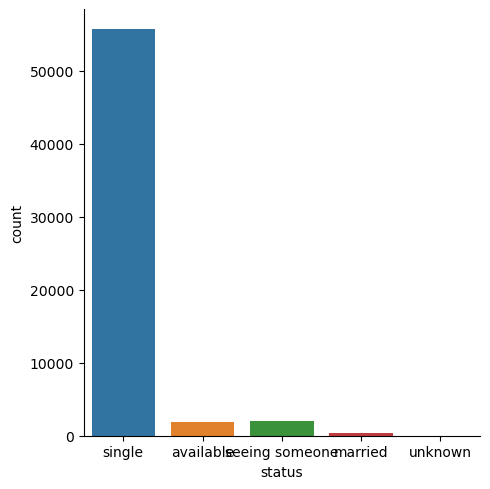

In [19]:
sns.catplot(x= "status", kind = "count", data = citas);

In [20]:
citas.groupby(['status']).size()

status
available          1865
married             310
seeing someone     2064
single            55697
unknown              10
dtype: int64

##### Número de personas por orientación sexual

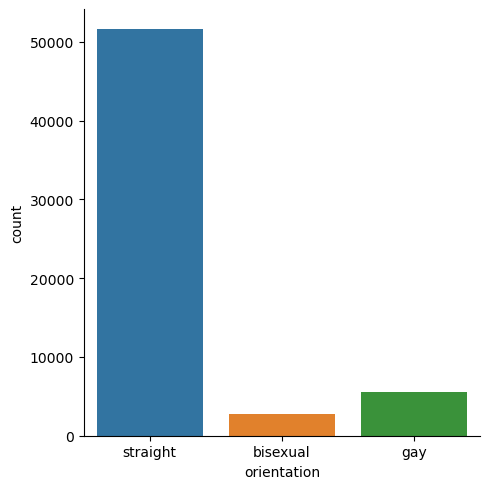

In [21]:
sns.catplot(x= "orientation", kind = "count", data = citas);

In [22]:
citas.groupby(['orientation']).size()

orientation
bisexual     2767
gay          5573
straight    51606
dtype: int64

##### Número de personas por body_type

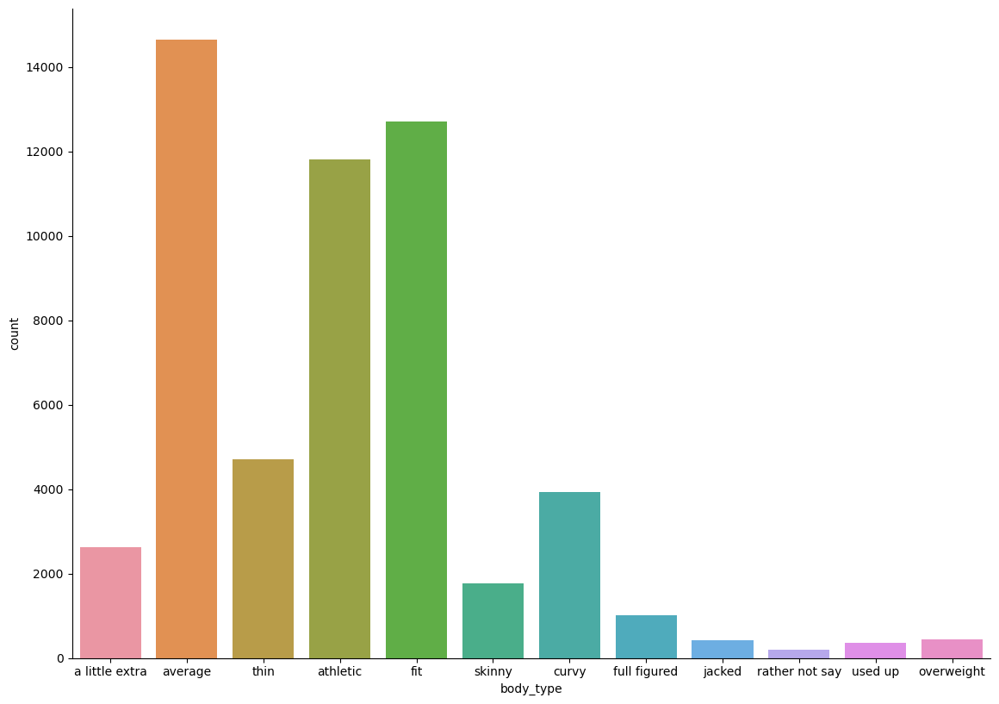

In [23]:
sns.catplot(x= "body_type", kind = "count", data = citas, height=8.27, aspect=11.7/8.27);

In [24]:
citas.groupby(['body_type']).size()

body_type
a little extra     2629
athletic          11819
average           14652
curvy              3924
fit               12711
full figured       1009
jacked              421
overweight          444
rather not say      198
skinny             1777
thin               4711
used up             355
dtype: int64

##### Número de personas por tipo de dieta

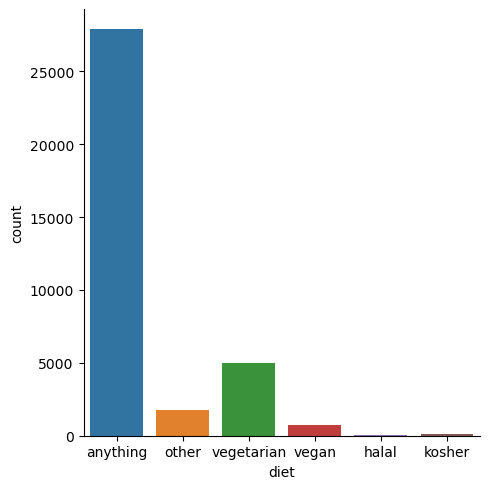

In [25]:
sns.catplot(x= "diet", kind = "count", data = citas);

In [26]:
citas.groupby(['diet']).size()

diet
anything      27881
halal            77
kosher          115
other          1790
vegan           702
vegetarian     4986
dtype: int64

##### Número de personas por el consumo de alcohol

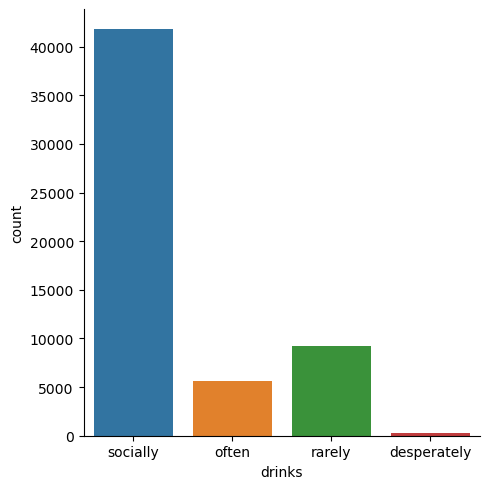

In [27]:
sns.catplot(x= "drinks", kind = "count", data = citas);

In [28]:
citas.groupby(['drinks']).size()

drinks
desperately      322
often           5635
rarely          9224
socially       41780
dtype: int64

##### Número de personas por el consumo de drogas

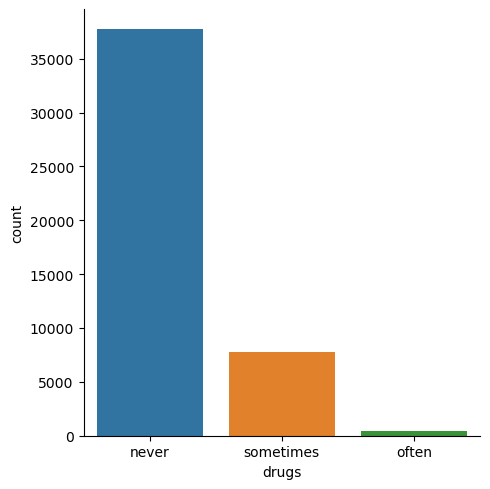

In [29]:
sns.catplot(x= "drugs", kind = "count", data = citas);

In [30]:
citas.groupby(['drugs']).size()

drugs
never        37724
often          410
sometimes     7732
dtype: int64

##### Número de personas por el consumo de tabaco

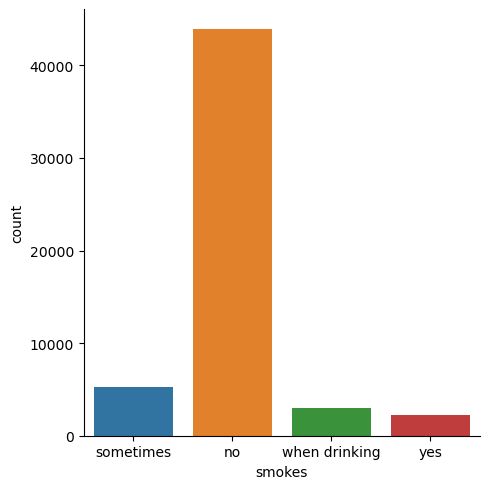

In [31]:
sns.catplot(x= "smokes", kind = "count", data = citas);

In [32]:
citas.groupby(['smokes']).size()

smokes
no               43896
sometimes         5267
when drinking     3040
yes               2231
dtype: int64

#### Análisis por sexos

***Equipo 1*** - *Repetimos el análisis anterior pero dividiendo por sexos.*

##### Orientación sexual

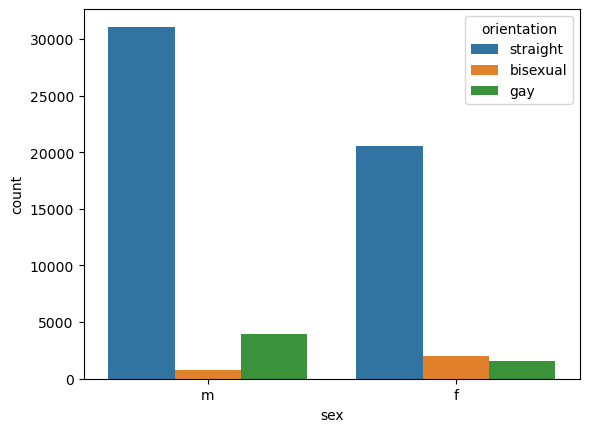

In [33]:
sns.countplot(x = "sex", hue="orientation", data = citas);

In [34]:
citas.groupby(['orientation', 'sex']).size()

orientation  sex
bisexual     f       1996
             m        771
gay          f       1588
             m       3985
straight     f      20533
             m      31073
dtype: int64

##### Status

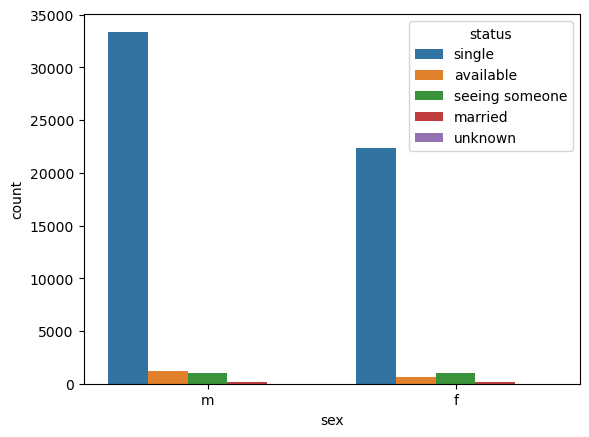

In [35]:
sns.countplot(x = "sex", hue="status", data = citas);

In [36]:
citas.groupby(['status', 'sex']).size()

status          sex
available       f        656
                m       1209
married         f        135
                m        175
seeing someone  f       1003
                m       1061
single          f      22319
                m      33378
unknown         f          4
                m          6
dtype: int64

***Equipo 1*** - *Comprobamos el estado 'unknown'.*

In [37]:
unknown = citas[citas["status"] == 'unknown']

In [38]:
unknown #Podría ser lo mismo que tener un valor nulo porque no da información

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
17337,57,unknown,m,gay,average,anything,rarely,NaN,70.0,no,22673BR
20367,38,unknown,m,straight,average,NaN,socially,NaN,68.0,NaN,95420PZ
31148,31,unknown,m,straight,athletic,NaN,socially,never,69.0,no,44206ER
32848,38,unknown,m,straight,NaN,NaN,socially,NaN,74.0,no,70137FY
38009,27,unknown,f,straight,NaN,NaN,rarely,never,64.0,no,74670GD
42771,37,unknown,m,straight,average,anything,socially,never,66.0,no,74620EC
45885,22,unknown,f,straight,curvy,anything,socially,never,61.0,no,21693QM
47999,26,unknown,f,straight,a little extra,anything,rarely,never,60.0,no,17004IS
50957,43,unknown,m,straight,fit,NaN,socially,NaN,72.0,no,85016VC
57301,36,unknown,f,straight,NaN,NaN,rarely,never,68.0,no,49279PF


##### Drinks

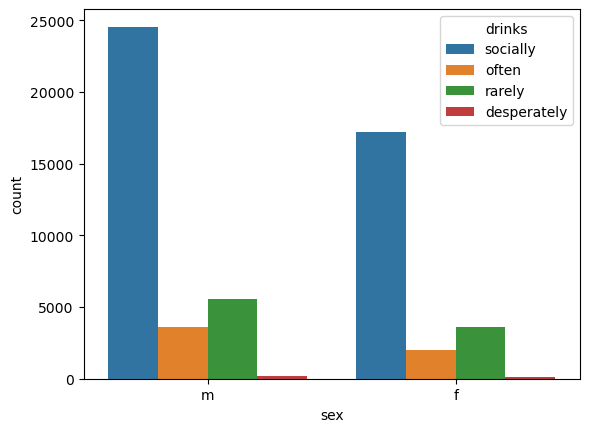

In [39]:
sns.countplot(x = "sex", hue="drinks", data = citas);

In [40]:
citas.groupby(['drinks', 'sex']).size()

drinks       sex
desperately  f        114
             m        208
often        f       2027
             m       3608
rarely       f       3641
             m       5583
socially     f      17223
             m      24557
dtype: int64

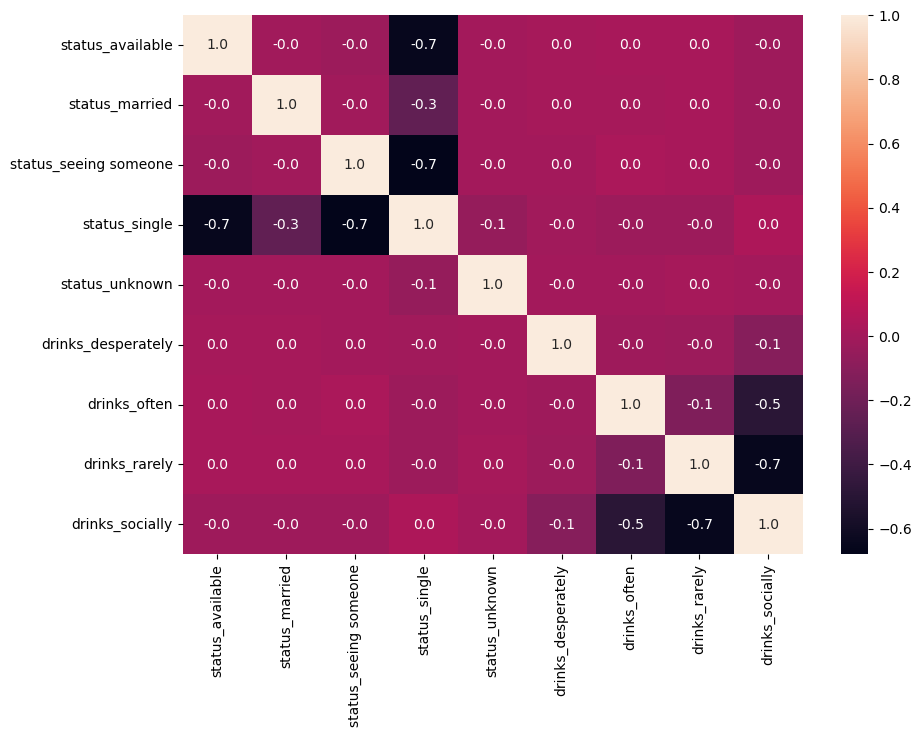

In [41]:
citas_dumm1 = citas_dumm[['status_available', 'status_married', 'status_seeing someone', 'status_single', 'status_unknown', 'drinks_desperately', 'drinks_often', 'drinks_rarely',
       'drinks_socially']]
correlation_matrix = citas_dumm1.corr().round(2)
plt.figure(figsize=(10,7))
#sns.heatmap(data=correlation_matrix, annot=True)
sns.heatmap(correlation_matrix, annot=True, fmt=".1f");

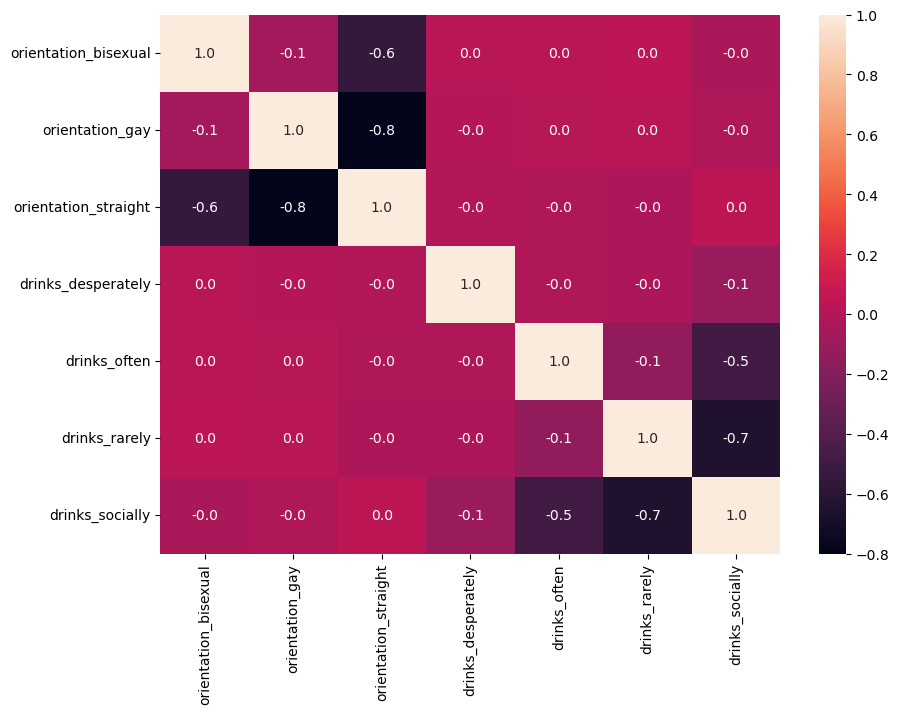

In [42]:
citas_dumm2 = citas_dumm[['orientation_bisexual', 'orientation_gay', 'orientation_straight', 'drinks_desperately', 'drinks_often', 'drinks_rarely', 'drinks_socially']]
correlation_matrix = citas_dumm2.corr().round(2)
plt.figure(figsize=(10,7))
#sns.heatmap(data=correlation_matrix, annot=True)
sns.heatmap(correlation_matrix, annot=True, fmt=".1f");

<Axes: >

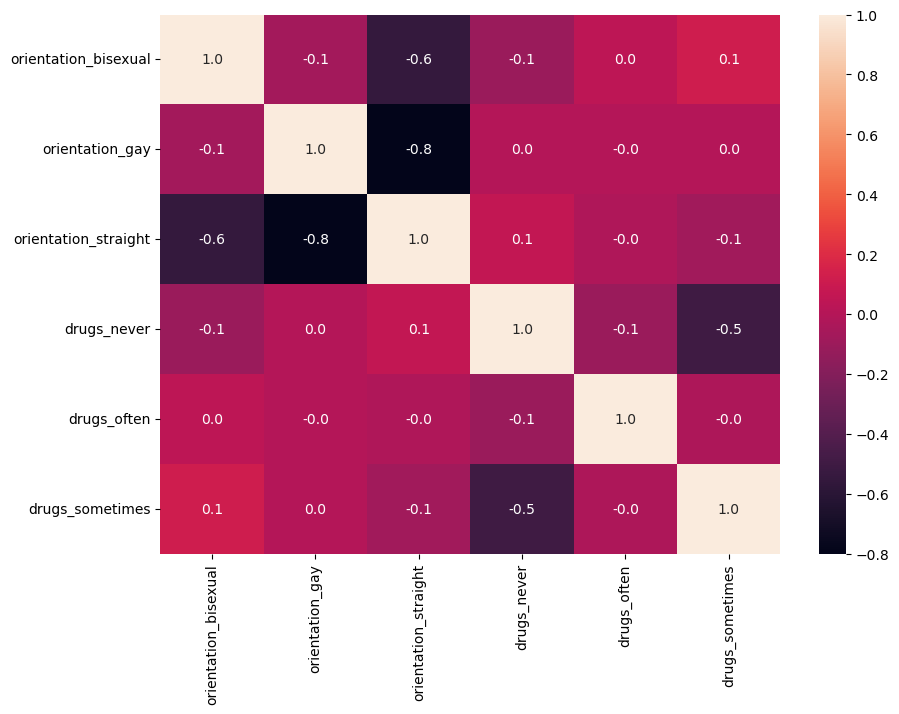

In [43]:
citas_dumm2 = citas_dumm[['orientation_bisexual', 'orientation_gay', 'orientation_straight', 'drugs_never', 'drugs_often', 'drugs_sometimes']]
correlation_matrix = citas_dumm2.corr().round(2)
plt.figure(figsize=(10,7))
#sns.heatmap(data=correlation_matrix, annot=True)
sns.heatmap(correlation_matrix, annot=True, fmt=".1f")

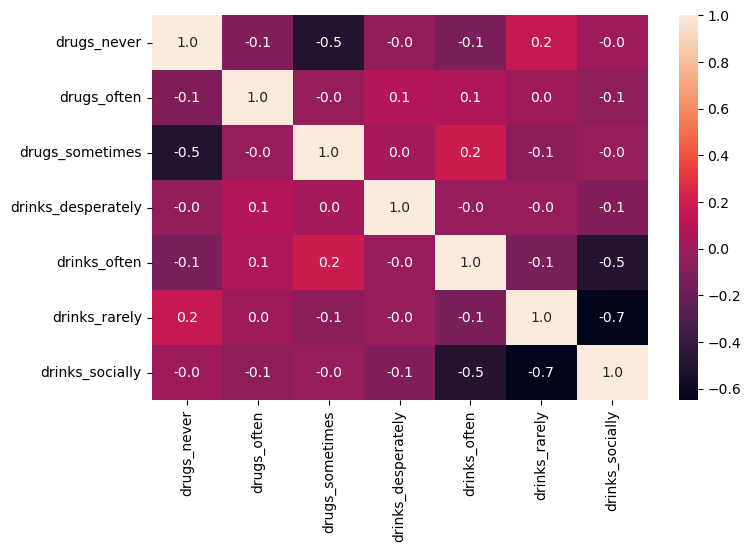

In [44]:
citas_dumm2 = citas_dumm[['drugs_never', 'drugs_often', 'drugs_sometimes', 'drinks_desperately', 'drinks_often', 'drinks_rarely', 'drinks_socially']]
correlation_matrix = citas_dumm2.corr().round(2)
plt.figure(figsize=(8,5))
#sns.heatmap(data=correlation_matrix, annot=True)
sns.heatmap(correlation_matrix, annot=True, fmt=".1f");

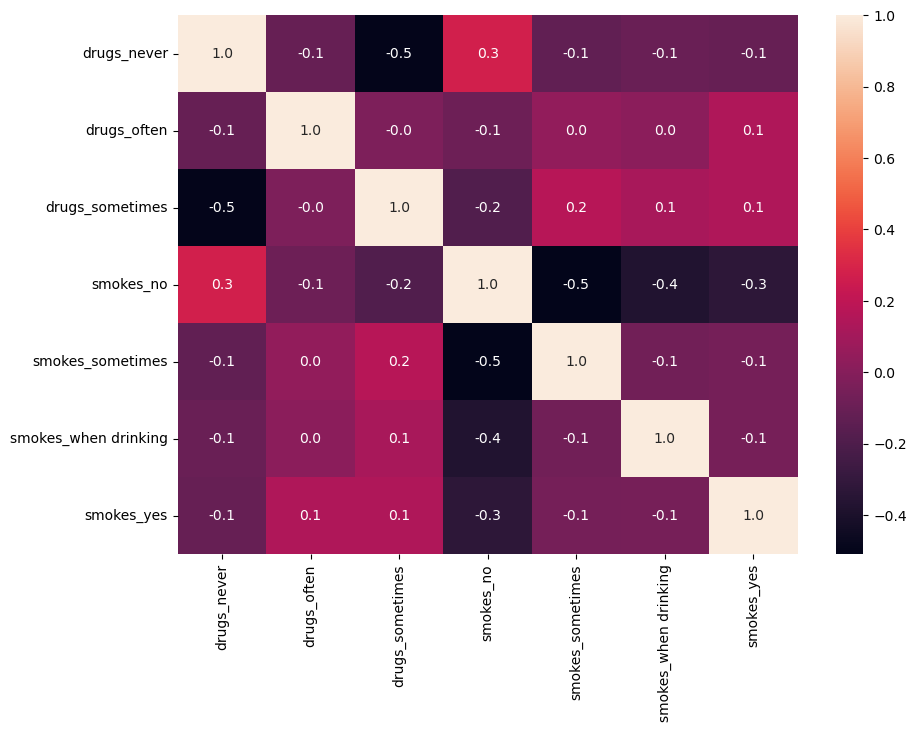

In [45]:
citas_dumm1 = citas_dumm[['drugs_never', 'drugs_often', 'drugs_sometimes', 'smokes_no', 'smokes_sometimes', 'smokes_when drinking', 'smokes_yes']]
correlation_matrix = citas_dumm1.corr().round(2)
plt.figure(figsize=(10,7))
#sns.heatmap(data=correlation_matrix, annot=True)
sns.heatmap(correlation_matrix, annot=True, fmt=".1f");

***Equipo 1*** - *Hay una pequeña correlación entre las personas que casi no beben y las que nunca toman drogas. También entre los que consumen drogas a veces y y los que beben a menudo.*

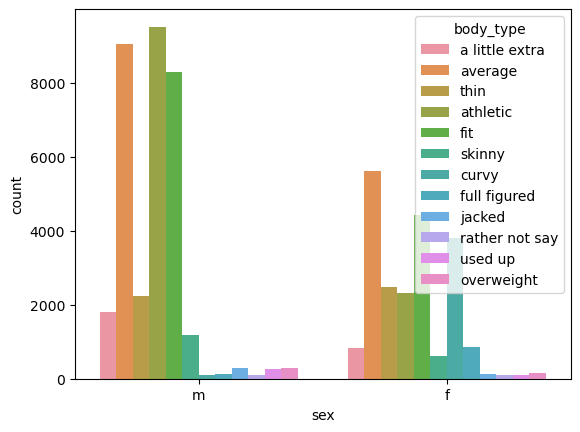

In [46]:
sns.countplot(x = "sex", hue="body_type", data = citas);

In [47]:
citas.groupby(['body_type', 'sex']).size()

body_type       sex
a little extra  f       821
                m      1808
athletic        f      2309
                m      9510
average         f      5620
                m      9032
curvy           f      3811
                m       113
fit             f      4431
                m      8280
full figured    f       870
                m       139
jacked          f       129
                m       292
overweight      f       145
                m       299
rather not say  f       106
                m        92
skinny          f       601
                m      1176
thin            f      2469
                m      2242
used up         f       102
                m       253
dtype: int64

##### Age

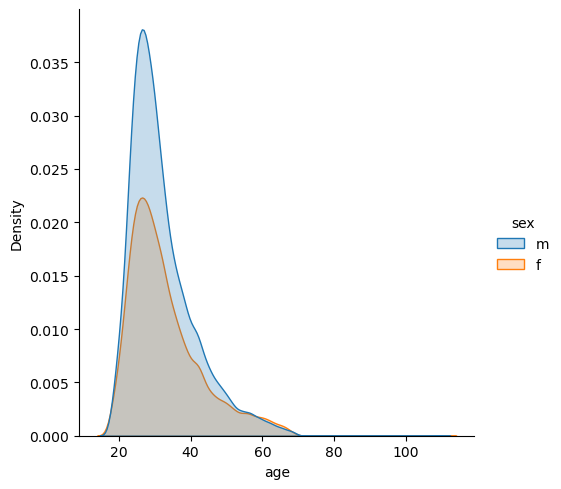

In [48]:
sns.displot(kind="kde", data= citas, x = "age", hue="sex", fill = "True");

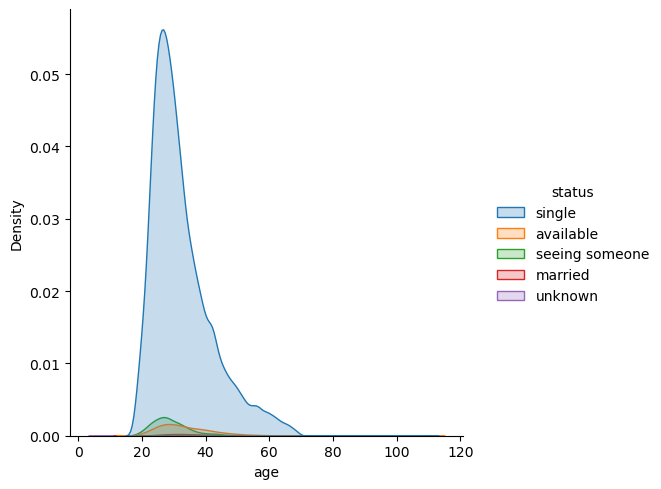

In [49]:
sns.displot(kind="kde", data= citas, x = "age", hue="status", fill = "True");

In [50]:
married = citas[citas["status"] == "married"]

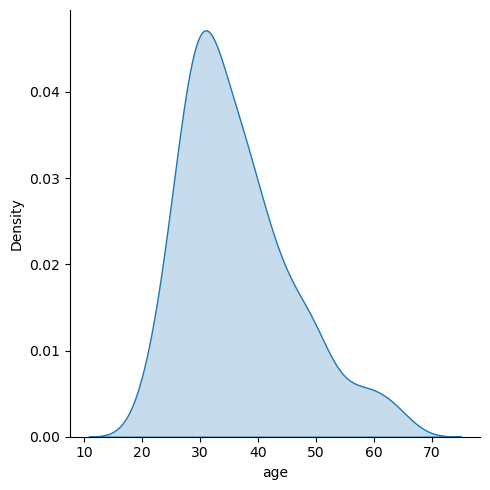

In [51]:
sns.displot(kind="kde", data= married, x = "age", fill = "True");

In [52]:
married.describe()

,age,height
count,310.000000,310.000000
mean,36.516129,68.322581
std,9.590890,4.076828
min,20.000000,58.000000
25%,29.000000,65.000000
50%,35.000000,68.000000
75%,42.000000,71.000000
max,66.000000,88.000000


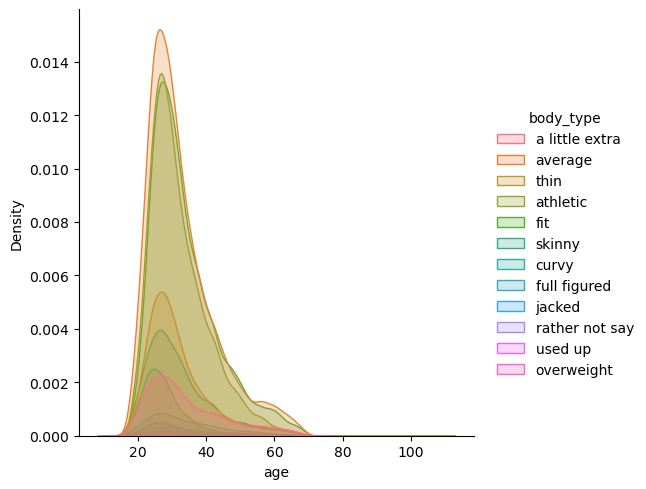

In [53]:
sns.displot(kind="kde", data= citas, x = "age", hue="body_type", fill = "True");

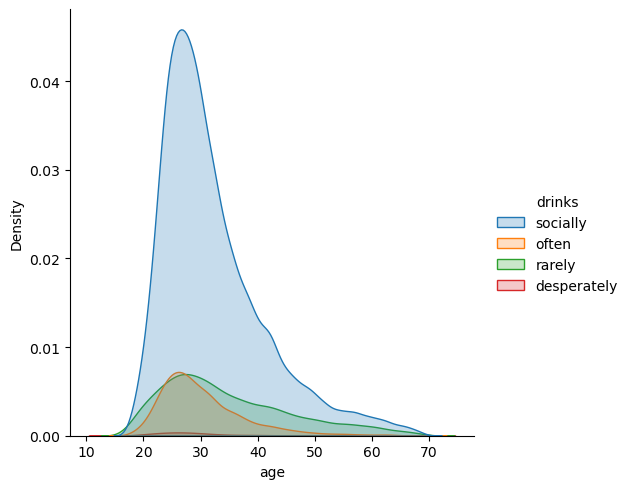

In [54]:
sns.displot(kind="kde", data= citas, x = "age", hue="drinks", fill = "True");

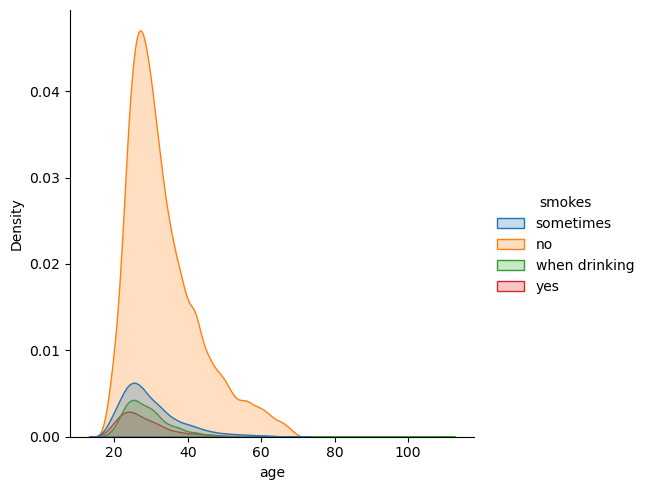

In [55]:
sns.displot(kind="kde", data= citas, x = "age", hue="smokes", fill = "True");

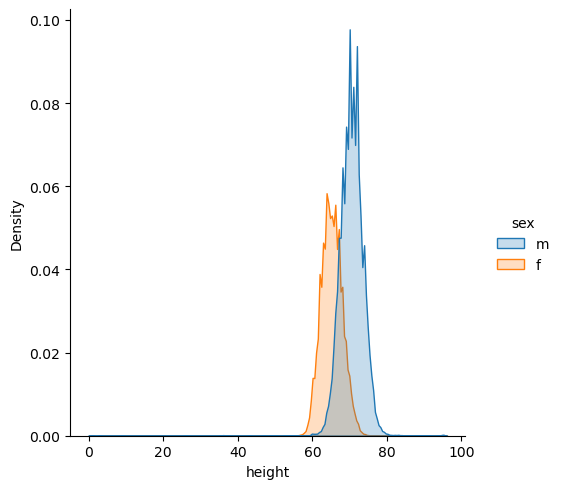

In [56]:
sns.displot(kind="kde", data= citas, x = "height", hue="sex", fill = "True");

### b) Realiza la limpieza de datos. Pero ojo, ¡no puedes eliminar a ningún usuario de la aplicación!

In [57]:
# Valores nulos de cada variable
citas.isna().sum()

age                0
status             0
sex                0
orientation        0
body_type       5296
diet           24395
drinks          2985
drugs          14080
height             3
smokes          5512
user               0
dtype: int64

#### Edad

***Equipo 1*** - *Como la media de ambos sexos es prácticamente igual, se sustituyen los dos valores atípicos de la edad por la media general.*

In [58]:
# Media de edad
age = citas['age'].mean()
age

32.3402895939679

In [59]:
# Imputamos los outliers de edad por la media anterior
citas_atypical_age["age"] = round(age)

In [60]:
# Visualizamos los resultados
citas_atypical_age

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
2512,32,single,f,straight,NaN,NaN,NaN,NaN,67.0,NaN,12327EJ
25324,32,available,m,straight,athletic,other,NaN,never,95.0,when drinking,52402QQ


In [61]:
# Juntamos los valores anteriores al dataset original
citas_age = citas[citas["age"] < 100]
citas = pd.concat([citas_age,citas_atypical_age])

#### Altura

***Equipo 1*** - *Se sustituyen los valores nulos y los atípicos por la mediana de la altura de cada sexo.*

In [62]:
# Hombres que pesen menos de 60 kg o mas de 80.
citas_atypical_height_male = citas[(citas["sex"] == 'm') & ((citas["height"] < 60) | (citas["height"] > 80))]

# Caso contrario para hombres
citas_height_male = citas[(citas["sex"] == 'm') & ((citas["height"] >= 60) & (citas["height"] <= 80))]

# Hombres sin peso informado
citas_height_male_nan = citas[(citas["sex"] == 'm') & (citas["height"].isna())]

In [63]:
# Mediana del peso de los hombres
median_height_male = citas_height_male["height"].median()
median_height_male

70.0

In [64]:
# Imputamos por la mediana para el primer y el tercer caso
citas_atypical_height_male["height"] = median_height_male
citas_height_male_nan["height"] = median_height_male

In [65]:
# Juntamos todo lo anterior
male = pd.concat([citas_height_male,citas_atypical_height_male,citas_height_male_nan])

In [66]:
# Mujeres que pesen menos de 57 y mas de 75
citas_atypical_height_female = citas[(citas["sex"] == 'f') & ((citas["height"] < 57) | (citas["height"] > 75))]

# Caso contrario para mujeres
citas_height_female = citas[(citas["sex"] == 'f') & ((citas["height"] >= 57) & (citas["height"] <= 75))]

# Mujeres sin peso informado
citas_height_female_nan = citas[(citas["sex"] == 'f') & (citas["height"].isna())]

In [67]:
# Mediana del peso femenino
median_height_female = citas_height_female["height"].median()
median_height_female

65.0

In [68]:
# Asignamos para el primer y tercer caso
citas_atypical_height_female["height"] = median_height_female
citas_height_female_nan["height"] = median_height_female

In [69]:
# Juntamos los casos anteriores
female = pd.concat([citas_height_female,citas_atypical_height_female,citas_height_female_nan])

In [70]:
# Juntamos la separacion entre hombres y mujeres
citas = pd.concat([male,female])

In [71]:
# Sustituimos 'diet', 'drinks' y 'smokes' por la moda
citas_null = ['diet', 'drinks', 'smokes']
citas[citas_null] = citas[citas_null].replace({np.nan:citas['diet'].mode()[0],
                                                np.nan:citas['drinks'].mode()[0],
                                                np.nan:citas['smokes'].mode()[0]})

In [72]:
# Separamos los casos que tiene 'drugs' informado
drugs_nonan = citas[(citas["drugs"].notna())]

In [73]:
# Casos que tienen drugs sin informar, no fuman y beben de vez en cuando
drugs_never = citas[(citas["drugs"].isna()) & (citas["smokes"] == 'no') & (citas["drinks"] == 'rarely')]

# Asginamos never a estos casos
drugs_never["drugs"] = 'never'

In [74]:
# Casos que tienen drugs sin informar, fuman y beben de vez en cuando
drugs_sometimes = citas[(citas["drugs"].isna()) & ~((citas["smokes"] == 'no') & (citas["drinks"] == 'rarely'))]

# Asginamos sometimes a estos casos
drugs_sometimes["drugs"] = 'sometimes'

In [75]:
# Juntamos todos los casos anteriores
citas = pd.concat([drugs_sometimes, drugs_never, drugs_nonan])

#### Métodos de clasificiación para intentar predecir el body_type de aquellos casos en los que el dato es null

In [76]:
# Separamos por aquellos en los que body_type esta informado y es na
citas_body = citas_filtered[citas_filtered["body_type"].notna()]
citas_body_na = citas_filtered[citas_filtered["body_type"].isna()]

In [77]:
# Separamos en variable a predecir y variables predictoras
trainfeature = citas_body.drop(['body_type', 'orientation', 'diet', 'status'],axis=1)
trainlabel = citas_body.loc[:,'body_type']
trainfeature.head()

,age,sex,drinks,drugs,height,smokes
0,22,m,socially,never,75.0,sometimes
1,35,m,often,sometimes,70.0,no
2,38,m,socially,NaN,68.0,no
3,23,m,socially,NaN,71.0,no
4,29,m,socially,never,66.0,no


In [78]:
# One Hot Encoding
citas_dummies = pd.get_dummies(trainfeature, dtype=int, drop_first = True)

In [79]:
# Division en x e y
X_train, X_test, y_train, y_test = train_test_split(citas_dummies, trainlabel, test_size=0.30, random_state=0)

In [80]:
# Estandarizamos los datos
std = StandardScaler()
X_train_std = std.fit_transform(X_train)
X_test_std = std.transform(X_test)

In [81]:
# Definimos los distintos modelos
reg = LogisticRegression()
svm = SVC()
nb = GaussianNB()
dt = DecisionTreeClassifier()
knn = KNeighborsClassifier(n_neighbors=5)

In [111]:
reg.fit(X_train_std, y_train.ravel())
svm.fit(X_train_std, y_train.ravel())
nb.fit(X_train_std, y_train.ravel())
dt.fit(X_train_std, y_train.ravel())
knn.fit(X_train_std, y_train.ravel())

KNeighborsClassifier()

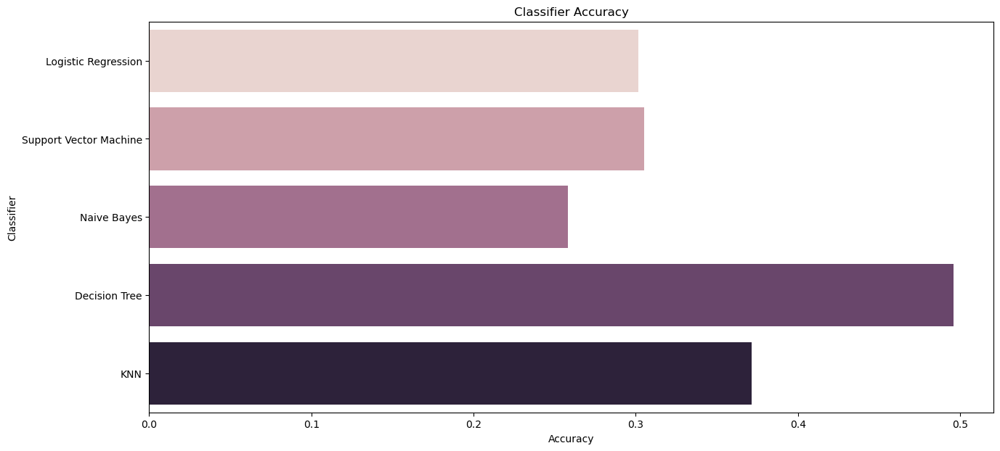

In [125]:
accuracyList = []
algorithm = []

#Calculo acc y almacena en lista
accuracyList.append(reg.score(X_train_std, y_train))
accuracyList.append(svm.score(X_train_std, y_train))
accuracyList.append(nb.score(X_train_std, y_train))
accuracyList.append(dt.score(X_train_std, y_train))
accuracyList.append(knn.score(X_train_std, y_train))

algorithm.append("Logistic Regression")
algorithm.append("Support Vector Machine")
algorithm.append("Naive Bayes")
algorithm.append("Decision Tree")
algorithm.append("KNN")

#Visualización gráficas:
f,ax = plt.subplots(figsize = (15,7))
sns.barplot(x=accuracyList,y=algorithm,palette = sns.cubehelix_palette(len(accuracyList)))
plt.xlabel("Accuracy")
plt.ylabel("Classifier")
plt.title('Classifier Accuracy')
plt.show()

***Equipo 1*** - *El accuracy es muy bajo, no merece la pena utilizar métodos de clasificación. Se sustituye por la moda global.*

In [82]:
citas["body_type"] = citas["body_type"].replace({np.nan:citas["body_type"].mode()[0]})

In [83]:
# Comprobamos que no quedan nulos
citas.isna().sum()

age            0
status         0
sex            0
orientation    0
body_type      0
diet           0
drinks         0
drugs          0
height         0
smokes         0
user           0
dtype: int64

#### Clustering

***Equipo 1*** - *Selección de las variables que se van a utilizar para hacer clustering. No se incluyen las variables sexo y orientación porque de esas variables depende la recomendación. Por otro lado, si se incluyen, en un mismo cluster se incluirán todos los hombres heterosexuales, por ejemplo, y esos no pueden ser emparejados entre sí. Nos interesa saber la agrupación por "forma de vida" y características físicas.*

In [84]:
citas_filtered = citas[["age","status", "body_type", "diet", "drinks", "drugs", "height", "smokes"]]

In [85]:
citas_filtered.head()

,age,status,body_type,diet,drinks,drugs,height,smokes
2,38,available,thin,anything,socially,sometimes,68.0,no
3,23,single,thin,vegetarian,socially,sometimes,71.0,no
5,29,single,average,anything,socially,sometimes,67.0,no
10,35,available,average,anything,socially,sometimes,70.0,yes
12,24,single,average,no,often,sometimes,72.0,no


In [86]:
# One Hote Encoding
citas_filtered_dumm = pd.get_dummies(citas_filtered, dtype=int, drop_first = True)

In [87]:
# Curva de codo para encontrar el número óptimo de clústers
elbow = []
numero_clusters = []
for i in range(1,15):
    model_kmeans = KMeans(n_clusters = i)
    model_kmeans.fit(citas_filtered_dumm)
    model_kmeans.predict(citas_filtered_dumm)
    elbow.append(model_kmeans.inertia_)
    numero_clusters.append(i)

  File "C:\Users\lidia\anaconda3\Lib\site-packages\joblib\externals\loky\backend\context.py", line 217, in _count_physical_cores
    raise ValueError(


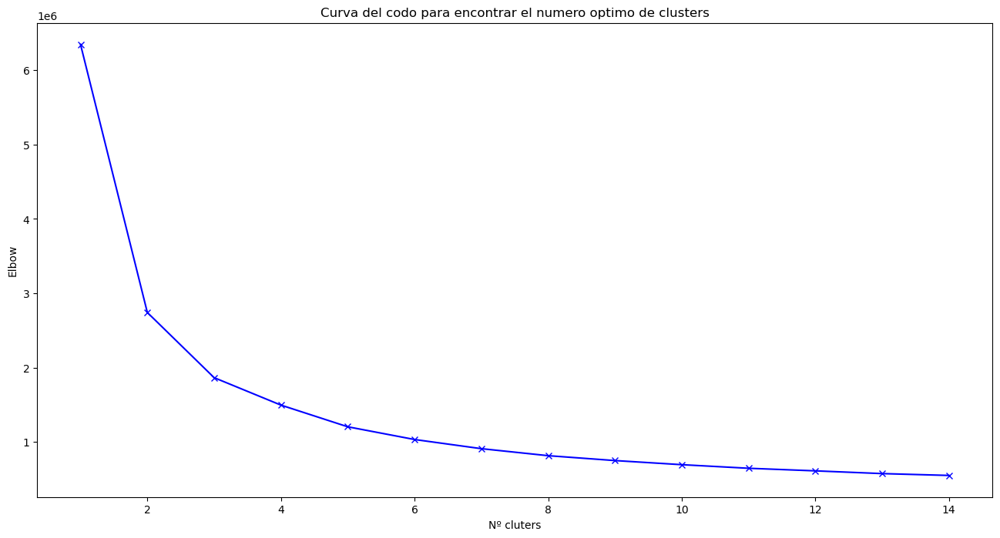

In [88]:
# Representacion gráfica
plt.figure(figsize=(16,8))
plt.plot(numero_clusters, elbow, 'bx-')
plt.xlabel('Nº cluters')
plt.ylabel('Elbow')
plt.title('Curva del codo para encontrar el numero optimo de clusters')
plt.show();

In [89]:
# Mejor modelo
model_kmeans = KMeans(n_clusters = 4)
model_kmeans.fit(citas_filtered_dumm)
labels = model_kmeans.predict(citas_filtered_dumm)

***Equipo 1*** - *Reducción de la dimensionalidad para poder visualizar los datos*

In [90]:
citas_embedded = TSNE(n_components=3, learning_rate='auto',init='random').fit_transform(citas_filtered_dumm)

***Equipo 1*** - *Se añaden las variables orientation, sex, user y cluster.*

In [91]:
citas_embedded = pd.DataFrame(citas_embedded)
citas_embedded["orientation"] = list(citas["orientation"])
citas_embedded["sex"] = list(citas["sex"])
citas_embedded["user"] = list(citas["user"])
citas_embedded["cluster"] = labels

In [92]:
citas_embedded.head()

,0,1,2,orientation,sex,user,cluster
0,26.460503,6.399118,20.008453,straight,m,55184RY,0
1,-17.624346,6.602457,-25.365883,straight,m,47777YP,3
2,-0.604594,-35.943424,-5.241358,straight,m,56621GV,1
3,27.238857,-1.191139,0.447209,straight,m,81654GA,0
4,-3.314319,7.360265,-12.870214,straight,m,31067FR,3


***Equipo 1*** - *Visualización del gráfico en 3D.*

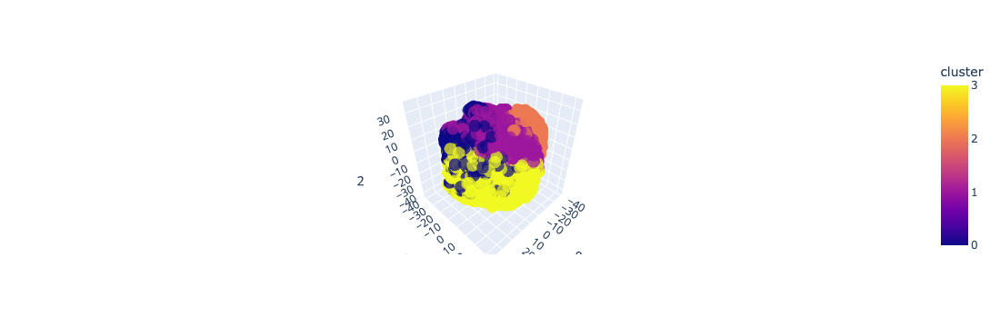

In [93]:
fig = px.scatter_3d(
    citas_embedded, x=0, y=1, z=2,color = "cluster", opacity=0.7, hover_name = "user")
fig.show()

### c) Implementa un sistema recomendador para el que, dado el identificador de un usuario, obtengamos aquellos perfiles con mayor propensión a la cita.

In [98]:
def filtrar_por_orientacion_y_sexo(df, user_id):
    #Filtra posibles candidatos para un usuario dado basado en su sexo y orientación sexual.

    # Obtener los detalles del usuario
    usuario = df[df['user'] == user_id]
    if usuario.empty:
        return pd.DataFrame()  # Retorna un DataFrame vacío si el usuario no se encuentra

    sexo_usuario = usuario['sex'].iloc[0]
    orientacion_usuario = usuario['orientation'].iloc[0]

    # Definir las posibles combinaciones de sexo y orientación para los candidatos
    if sexo_usuario == 'm':
        if orientacion_usuario == 'straight':
            condiciones = ((df['sex'] == 'f') & (df['orientation'].isin(['straight', 'bisexual'])))
        elif orientacion_usuario == 'gay':
            condiciones = ((df['sex'] == 'm') & (df['orientation'].isin(['gay', 'bisexual'])))
        else:  # bisexual
            condiciones = ~((df['sex'] == 'm') & (df['orientation'] == 'straight') |
                            (df['sex'] == 'f') & (df['orientation'] == 'gay'))
    else:  # mujer
        if orientacion_usuario == 'straight':
            condiciones = ((df['sex'] == 'm') & (df['orientation'].isin(['straight', 'bisexual'])))
        elif orientacion_usuario == 'gay':
            condiciones = ((df['sex'] == 'f') & (df['orientation'].isin(['gay', 'bisexual'])))
        else:  # bisexual
            condiciones = ~((df['sex'] == 'f') & (df['orientation'] == 'straight') |
                            (df['sex'] == 'm') & (df['orientation'] == 'gay'))

    candidatos = df[condiciones]
    df_candidates = pd.concat([usuario, candidatos])
    
    citas_filtered = df_candidates[["age","status", "body_type", "diet", "drinks", "drugs", "height", "smokes"]]
    citas_filtered_dumm = pd.get_dummies(citas_filtered, dtype=int, drop_first = True)
    
    #Sistema recomendador. Algoritmo KNN
    n_users = 6
    neighbors = NearestNeighbors(n_neighbors= n_users, metric = "cosine")
    neighbors.fit(citas_filtered_dumm)
    
    #Calcular distancias y vecinos más similares
    top_distancias, top_users = neighbors.kneighbors(citas_filtered_dumm, return_distance=True)
    
    df_candidates = df_candidates.reset_index(drop=True)
    
    #Dado un usuario, se buscan los más similares
    indice = df_candidates[df_candidates['user'] == user_id].index[0]
    recomendaciones_users =  df_candidates['user'].loc[top_users[indice]].values
    cand = list(recomendaciones_users[1:]) #Se convierten los usuarios a lista para poder obtener el DataFrame de esos usuarios
    
    condiciones = df['user'].isin(cand)
    
    candidatos = df[condiciones]
    
    return candidatos

In [99]:
citas = citas.reset_index(drop=True)

In [107]:
# Ejemplo de uso para un usuario específico, el primer usuario del dataset como ejemplo
usuario_ejemplo = citas['user'].iloc[53600]
candidatos_filtrados = filtrar_por_orientacion_y_sexo(citas, usuario_ejemplo)

In [108]:
citas[citas['user'] == usuario_ejemplo]

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
53600,23,single,f,straight,average,no,no,never,70.0,no,71671XW


In [109]:
candidatos_filtrados

,age,status,sex,orientation,body_type,diet,drinks,drugs,height,smokes,user
20667,23,single,m,straight,average,no,no,never,71.0,no,87736YL
22037,23,single,m,straight,average,no,no,never,71.0,no,54694NU
30415,24,single,m,straight,average,no,no,never,73.0,no,98494VV
31933,23,single,m,straight,average,no,no,never,71.0,no,41905MZ
38027,23,single,m,straight,average,no,no,never,70.0,no,96604EM


## [EJERCICIO 2] Fútbol Manager: ¿Cuál es la cláusula adecuada para cada futbolista?

Es bien sabido que el mundo del fútbol es un sector que mueve millones de euros. Ahora bien, cualquier error al ”blindar” a los jugadores puede hacer que perdamos oportunidades de negocio y que, al mismo tiempo, el rendimiento no se ajuste a sus sueldos. 

Como Manager, deberás ser capaz de ajustar las cláusulas (*Release Clause*) de distintos futbolistas empleando únicamente modelos neuronales. Para ello, nos proponen un conjunto de datos que contienen información sobre el rendimiento de distintos jugadores a nivel mundial.

In [397]:
fifa = pd.read_csv("https://raw.githubusercontent.com/timzatko/fifa-19-dataset-machine-learning/master/data/fifa.csv", sep = ",")

### a) Realiza el análisis exploratorio de datos. ¿Hay alguna conclusión o hipótesis importante que debamos ser sabida?

In [398]:
# Tamaño del dataset
fifa.shape

(18207, 88)

In [399]:
# Visualizamos las primers filas
fifa.head()

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,€110.5M,€565K,2202,Left,5.0,4.0,4.0,Medium/ Medium,Messi,Yes,RF,10.0,"Jul 1, 2004",NaN,2021,5'7,159lbs,88+2,88+2,88+2,92+2,93+2,93+2,93+2,92+2,93+2,93+2,93+2,91+2,84+2,84+2,84+2,91+2,64+2,61+2,61+2,61+2,64+2,59+2,47+2,47+2,47+2,59+2,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,€226.5M
1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,€77M,€405K,2228,Right,5.0,4.0,5.0,High/ Low,C. Ronaldo,Yes,ST,7.0,"Jul 10, 2018",NaN,2022,6'2,183lbs,91+3,91+3,91+3,89+3,90+3,90+3,90+3,89+3,88+3,88+3,88+3,88+3,81+3,81+3,81+3,88+3,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,€127.1M
2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,€118.5M,€290K,2143,Right,5.0,5.0,5.0,High/ Medium,Neymar,Yes,LW,10.0,"Aug 3, 2017",NaN,2022,5'9,150lbs,84+3,84+3,84+3,89+3,89+3,89+3,89+3,89+3,89+3,89+3,89+3,88+3,81+3,81+3,81+3,88+3,65+3,60+3,60+3,60+3,65+3,60+3,47+3,47+3,47+3,60+3,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,€228.1M
3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,€72M,€260K,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,"Jul 1, 2011",NaN,2020,6'4,168lbs,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,€138.6M
4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,€102M,€355K,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,"Aug 30, 2015",NaN,2023,5'11,154lbs,82+3,82+3,82+3,87+3,87+3,87+3,87+3,87+3,88+3,88+3,88+3,88+3,87+3,87+3,87+3,88+3,77+3,77+3,77+3,77+3,77+3,73+3,66+3,66+3,66+3,73+3,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,€196.4M


***Equipo 1*** - *De la visualización anterior vemos que hay variables como `ID` o `Photo` que contienen valores como identificadores o URLs que, a priori, no aportan mucha información. Vamos a ver el porcentaje de valores únicos de las distintas variables y eliminaremos aquellas con mayor valor, ya que no aportarán información.*

In [400]:
# Porcentaje de valores únicos
(fifa.nunique()/len(fifa)*100).sort_values(ascending=False).iloc[:10]

ID                100.000000
Photo             100.000000
Name               94.436206
Joined              9.534794
Special             7.810183
Release Clause      6.832537
Club Logo           3.729335
Club                3.575548
Loaned From         1.872906
Value               1.191849
dtype: float64

***Equipo 1*** - *Vamos a transformar las variables `Release Clause`, `Value` y `Wage` para ponerla en un formato numérico. Para ello, creamos primero una variable que indique la magnitud de la variable ('k' o 'M'), nos quedamos después con la parte numérica, y multiplicamos ambas cifras para obtener el resultado final.*

In [401]:
# Creamos un diccionario que mapee los valores de la magnitud
magnitude_dict = {'K': 1000, 'M':1000000}

# Separamos 'Release Clause' en dos partes (magnitud mapeada y valor numerico)
fifa['Magnitude RC'] = fifa['Release Clause'].str[-1:].map(magnitude_dict)
fifa['Numeric Value RC'] = fifa['Release Clause'].str[1:-1].astype('float')
fifa['Magnitude Value'] = fifa['Value'].str[-1:].map(magnitude_dict)
fifa['Numeric Value Value'] = fifa['Value'].str[1:-1].replace('', '0').astype('float') 
fifa['Magnitude Wage'] = fifa['Wage'].str[-1:].map(magnitude_dict)
fifa['Numeric Value Wage'] = fifa['Wage'].str[1:-1].replace('', '0').astype('float')

# Multiplicamos ambos valores para obtener el valor numerico de 'Release Clause'
fifa['Release Clause'] = fifa['Magnitude RC']*fifa['Numeric Value RC']
fifa['Value'] = fifa['Magnitude Value']*fifa['Numeric Value Value']
fifa['Wage'] = fifa['Magnitude Wage']*fifa['Numeric Value Wage']

# Eliminamos las variables 'Magnitude' y 'Numeric Value'
fifa.drop(['Magnitude RC', 'Numeric Value RC', 'Magnitude Value', 'Numeric Value Value', 'Magnitude Wage', 'Numeric Value Wage'], axis=1, inplace=True)

In [402]:
# Comprobamos que el cambio se harealizado correctamente
fifa.sample(5)

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
1440,209827,J. Fernandes,29,https://cdn.sofifa.org/players/4/19/209827.png,Chile,https://cdn.sofifa.org/flags/55.png,76,76,Alanyaspor,https://cdn.sofifa.org/teams/2/light/113142.png,7500000.0,16000.0,1899,Right,1.0,4.0,4.0,High/ Low,Normal,No,LM,11.0,"Sep 12, 2017",NaN,2020,6'0,172lbs,76+2,76+2,76+2,75+2,75+2,75+2,75+2,75+2,74+2,74+2,74+2,74+2,68+2,68+2,68+2,74+2,57+2,55+2,55+2,55+2,57+2,53+2,50+2,50+2,50+2,53+2,70.0,76.0,77.0,74.0,69.0,78.0,66.0,60.0,62.0,78.0,78.0,79.0,78.0,73.0,63.0,75.0,67.0,75.0,79.0,72.0,70.0,30.0,76.0,69.0,66.0,70.0,29.0,35.0,21.0,7.0,12.0,6.0,15.0,14.0,15000000.0
16937,233931,K. Rowles,20,https://cdn.sofifa.org/players/4/19/233931.png,Australia,https://cdn.sofifa.org/flags/195.png,56,71,Central Coast Mariners,https://cdn.sofifa.org/teams/2/light/111396.png,180000.0,1000.0,1295,Left,1.0,2.0,2.0,Medium/ Medium,Lean,No,LWB,15.0,"Jun 26, 2017",NaN,2019,6'0,181lbs,37+2,37+2,37+2,36+2,35+2,35+2,35+2,36+2,35+2,35+2,35+2,38+2,38+2,38+2,38+2,38+2,49+2,48+2,48+2,48+2,49+2,51+2,54+2,54+2,54+2,51+2,26.0,16.0,49.0,43.0,31.0,27.0,24.0,22.0,32.0,38.0,67.0,66.0,60.0,45.0,64.0,34.0,72.0,67.0,70.0,27.0,58.0,52.0,27.0,29.0,33.0,41.0,53.0,58.0,55.0,13.0,12.0,6.0,10.0,9.0,338000.0
16193,222931,J. Doherty,22,https://cdn.sofifa.org/players/4/19/222931.png,Northern Ireland,https://cdn.sofifa.org/flags/35.png,58,69,Crawley Town,https://cdn.sofifa.org/teams/2/light/110890.png,190000.0,1000.0,1488,Left,1.0,3.0,2.0,Medium/ High,Lean,Yes,LB,3.0,"Sep 5, 2017",NaN,2020,5'10,154lbs,47+2,47+2,47+2,48+2,46+2,46+2,46+2,48+2,43+2,43+2,43+2,49+2,43+2,43+2,43+2,49+2,56+2,51+2,51+2,51+2,56+2,57+2,58+2,58+2,58+2,57+2,58.0,22.0,55.0,36.0,28.0,57.0,45.0,29.0,31.0,54.0,67.0,69.0,63.0,53.0,57.0,66.0,66.0,62.0,69.0,20.0,57.0,57.0,44.0,31.0,72.0,73.0,59.0,61.0,59.0,9.0,10.0,9.0,11.0,7.0,449000.0
11523,238978,F. Schiller,28,https://cdn.sofifa.org/players/4/19/238978.png,Germany,https://cdn.sofifa.org/flags/21.png,64,65,VfL Osnabrück,https://cdn.sofifa.org/teams/2/light/487.png,400000.0,1000.0,1319,Right,1.0,3.0,2.0,Medium/ Medium,Stocky,No,CB,25.0,"Jul 1, 2018",NaN,2020,6'3,176lbs,40+2,40+2,40+2,34+2,35+2,35+2,35+2,34+2,33+2,33+2,33+2,36+2,39+2,39+2,39+2,36+2,50+2,53+2,53+2,53+2,50+2,54+2,63+2,63+2,63+2,54+2,36.0,25.0,67.0,38.0,27.0,28.0,29.0,30.0,39.0,35.0,42.0,50.0,43.0,58.0,42.0,52.0,65.0,61.0,85.0,22.0,75.0,57.0,22.0,29.0,32.0,58.0,64.0,64.0,64.0,9.0,6.0,6.0,8.0,9.0,610000.0
17387,239477,A. Damlu,18,https://cdn.sofifa.org/players/4/19/239477.png,Turkey,https://cdn.sofifa.org/flags/48.png,54,71,Yeni Malatyaspor,https://cdn.sofifa.org/teams/2/light/113259.png,110000.0,1000.0,835,Right,1.0,2.0,1.0,Medium/ Medium,Normal,No,GK,35.0,"Jul 25, 2016",NaN,2019,5'11,157lbs,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,5.0,13.0,17.0,5.0,5.0,11.0,14.0,18.0,16.0,27.0,20.0,31.0,48.0,47.0,23.0,59.0,21.0,43.0,8.0,26.0,13.0,6.0,21.0,19.0,31.0,22.0,11.0,11.0,57.0,58.0,48.0,47.0,55.0,289000.0


***Equipo 1*** - *Vamos a analizar algunas de las variables de dataset para tratar de extraer conclusiones.*

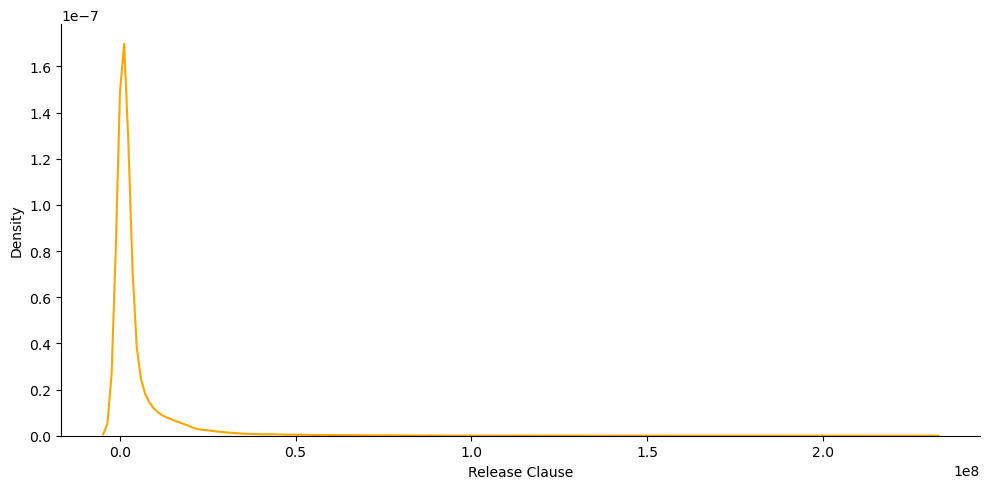

In [403]:
# Ánalsis de la variable objetivo
sns.displot(x='Release Clause', data=fifa, kind='kde', height=5 , aspect =2, color='orange');

***Equipo 1*** - *Como podemos observar en la gráfica anterior, la variable objetivo `Release Clause`, se distribuye principalmente en valores bajos. Vamos ahora a ver si esta cláusula guarda relación drecta con alguna otra variable. A priori, tiene sentido que la cláusula sea mayor cuánto mayor es la valoración del jugador (`Overall`) y cuanto mayor es su valor (`Value`).*

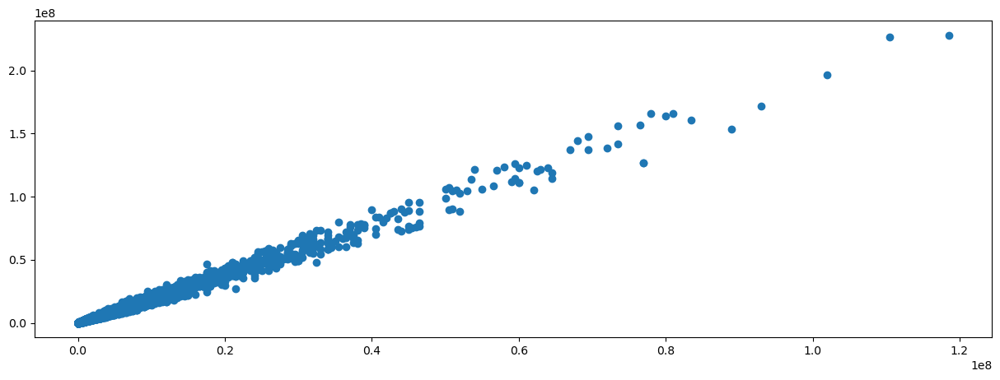

In [404]:
# Relación entre 'Release Clause' y 'Value'
plt.figure(figsize=(15,5))
plt.scatter(y=fifa['Release Clause'], x=fifa['Value']);

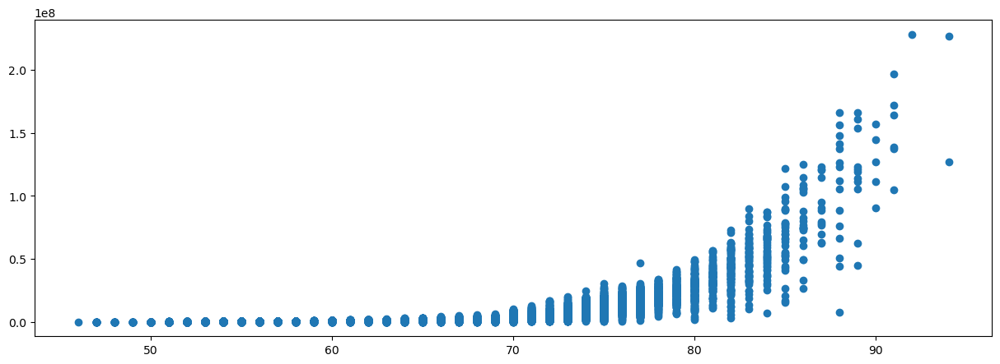

In [405]:
# Relación entre 'Release Clause' y 'Overall'
plt.figure(figsize=(15,5))
plt.scatter(y=fifa['Release Clause'], x=fifa['Overall']);

***Equipo 1*** - *Como podemos ver en el primer gráfico, la relación entre el valor del jugador (`Value`) y su cláusula de rescisión (`Release Clause`) es una relación practicamente lineal. Esto significa que a mayor valor mayor cláusula. Por otro lado también podemos ver en la segunda gráfica, donde se compara la cláusula con la valoración media (`Overall`), como también a mayor valoración mayor cláusula. En este segundo caso no se trata de una relación lineal como en la primera.*

***Equipo 1*** - *Hay otras variables que a priori también pueden guardar relación directa con la variable objetivo. El salario (`Wage`) ya que un jugador, a priori, cuanto mejor es, mayor salario tiene. Vamos a analizar la relación del salario con la cláusula de rescisión y con la variable `Overall` ya que, quizás, aporten la misma información.*

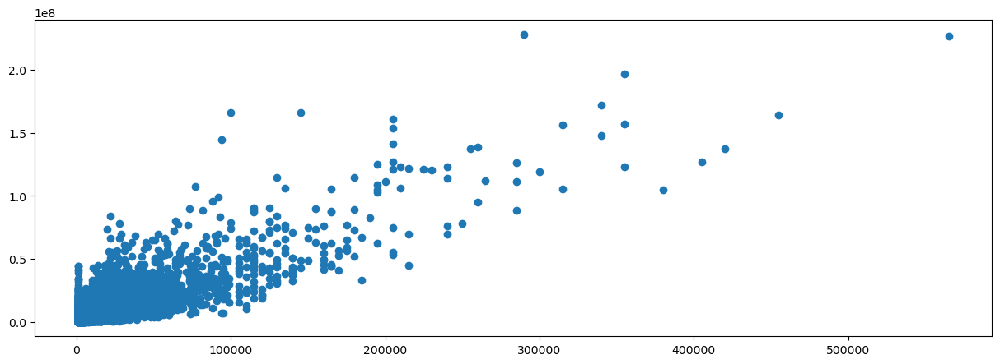

In [406]:
# Relación entre 'Release Clause' y 'Wage'
plt.figure(figsize=(15,5))
plt.scatter(y=fifa['Release Clause'], x=fifa['Wage']);

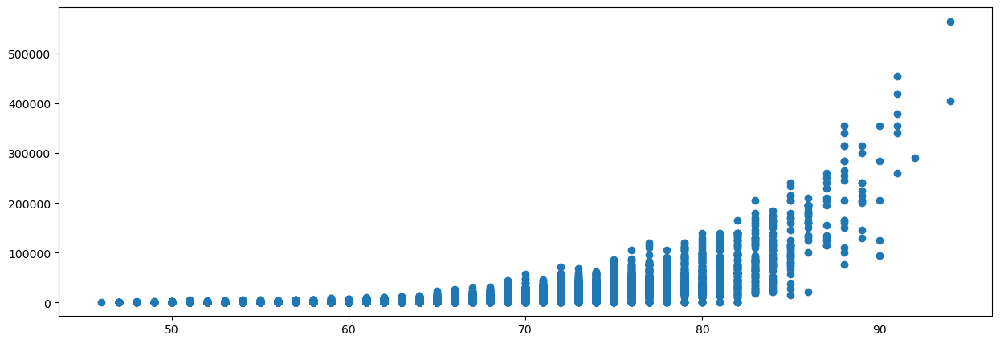

In [407]:
# Relación entre 'Overall' y 'Wage'
plt.figure(figsize=(15,5))
plt.scatter(y=fifa['Wage'], x=fifa['Overall']);

***Equipo 1*** - *Al igual que sucedía en el caso anterior vemos como también existe una relación entre el salario y la cláusula de rescisión. En este caso, no es una relación tan directa como su valor, pero también se puede ver como, a menor salario, menor cláusula. Existe también una relación entre el salario y la valoración del jugador, de forma que, a medida que aumenta la valoración también lo hace su salario. No obstante, no es una relación lineal.*

***Equipo 1*** - *Otros factores que pueden tener influencia en la cláusula de rescisión es la posición del jugador (`Position`) y la fecha de finalización de su contrato (`Contract Valid Until`).*

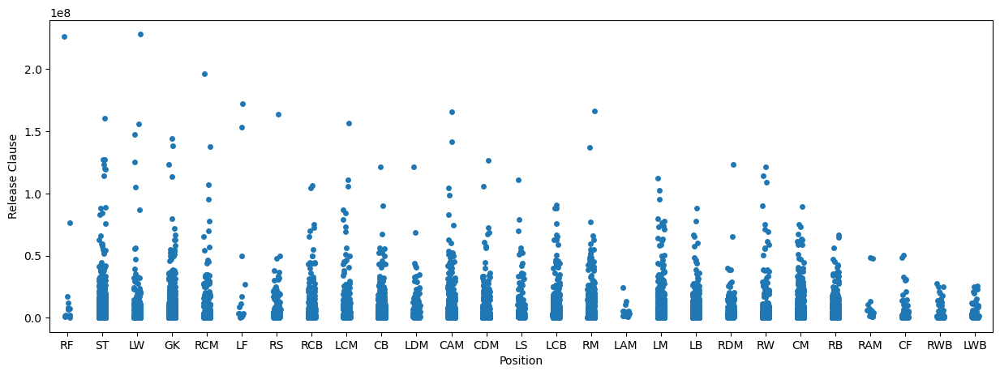

In [408]:
# Relación entre 'Release Clause' y 'Position'
plt.figure(figsize=(15, 5))
sns.stripplot(x='Position', y='Release Clause', data=fifa);

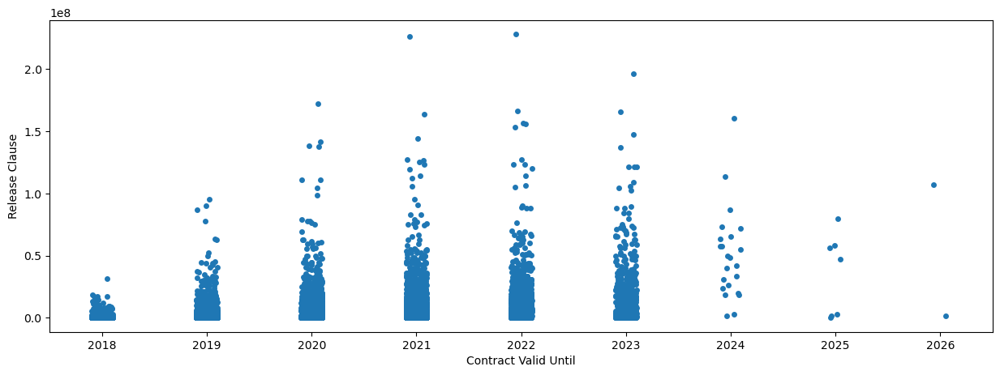

In [409]:
# Relación entre 'Release Clause' y 'Contract Valid Until'
plt.figure(figsize=(15, 5))
sns.stripplot(x=fifa['Contract Valid Until'].str[-4:], y='Release Clause', data=fifa, order=range(2018,2027,1));

***Equipo 1*** - *En estos casos que acabamos de ver no existe una relación directa entre las variables de forma que no podemos extraer grandes conclusiones. En el caso de las posiciones existen algunas como 'LF', 'RM' o 'RCM' que parecen tener los valores más altos, pero entre las demás posiciones se distribuyen de manera similar. Igual ocurre con el caso de las fechas de finalización de los contratos. La mayoría se concrentran en los valores centrales.*

***Equipo 1*** - *Por último, vamos a hacer una análisis de las distintas variables que hacen referencia a los atributos de cada futbolista. La idea es ver si hay alguna de ellas que sea especialmente relevante a la hora de determinar la `Release Clause` de cada jugador. vemos la correlación entre cada una y la variable objetivo*

In [410]:
# Columnas a representar
cols_plot = ['Crossing', 'Finishing', 'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling', 'Curve', 'FKAccuracy', 'LongPassing',
             'BallControl', 'Acceleration', 'SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower', 'Jumping', 'Stamina',
             'Strength', 'LongShots', 'Aggression', 'Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure', 'Marking',
             'StandingTackle', 'SlidingTackle', 'GKDiving', 'GKHandling', 'GKKicking', 'GKPositioning', 'GKReflexes', 'Release Clause']

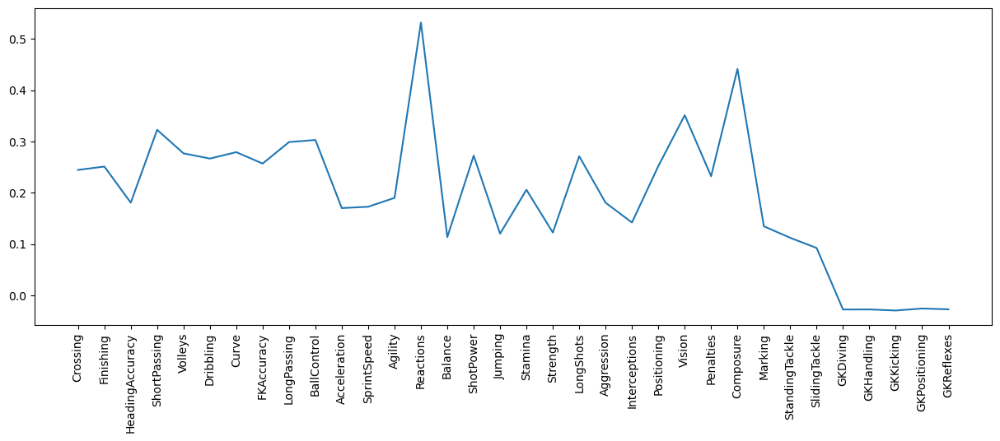

In [411]:
# Representación de la correlación de cada variable con la variable objetivo
plt.figure(figsize=(15, 5))
plt.plot(fifa[cols_plot].corr().loc['Release Clause'].drop('Release Clause'))
plt.xticks(rotation=90)
plt.show()

***Equipo 1*** - *Vemos que, de forma general, todas las variables estan entre 30 y 40 por ciento de correlación con `Release Clause`. No obstante, cabe destacar que hay dos en concreto (`Reactions` y `Composure`) que tienen un valor muy superior (en torno al 50%) y que podrían influir mucho en la cláusula. Hay otras, relacionadas con los porteros ('GK') que no tienen ninguna relevancia.*

***Equipo 1*** - ***CONCLUSIÓN**: Por lo que podemos observar en las gráficas anteriores, la hipótesis principal que plantearíamos es que `Release Clause`tiene una relación directa con el valor (`Value`) del jugador. Tiene todo el sentido del mundo ya que a mayor valor mayor cláusula debería tener el jugador para que no le fiche otro equipo. Existen otras variables que, de la misma forma, mantienen una relación directa (aunque no tan evidente como `Value`) con la variable objetivo, como pueden ser `Overall` y `Wage`. Respecto de los atributos de los futbolistas, se ha visto que hay dos (`Reactions` y `Composure`) que podrían influir mucho en la cláusula. Veremos en los siguientes apartados que variables son más relevantes.*

### b) Estudia la calidad de los datos.

In [412]:
# Visualización de columnas aleatorias
fifa.sample(3)

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
15126,240577,K. Khosonov,20,https://cdn.sofifa.org/players/4/19/240577.png,Russia,https://cdn.sofifa.org/flags/40.png,60,72,PFC CSKA Moscow,https://cdn.sofifa.org/teams/2/light/315.png,375000.0,1000.0,1653,Right,1.0,3.0,2.0,Medium/ Medium,Lean,No,CM,80.0,"Aug 31, 2015",NaN,2019,6'1,168lbs,57+2,57+2,57+2,57+2,58+2,58+2,58+2,57+2,58+2,58+2,58+2,57+2,58+2,58+2,58+2,57+2,58+2,59+2,59+2,59+2,58+2,58+2,59+2,59+2,59+2,58+2,41.0,53.0,59.0,64.0,34.0,61.0,49.0,64.0,61.0,60.0,60.0,70.0,50.0,58.0,68.0,62.0,63.0,57.0,48.0,50.0,65.0,56.0,55.0,55.0,50.0,51.0,57.0,62.0,64.0,9.0,6.0,15.0,13.0,14.0,900000.0
17834,245175,G. Severinsen,18,https://cdn.sofifa.org/players/4/19/245175.png,Norway,https://cdn.sofifa.org/flags/36.png,52,69,Tromsø IL,https://cdn.sofifa.org/teams/2/light/418.png,90000.0,1000.0,1401,Right,1.0,2.0,2.0,Medium/ Medium,Normal,No,CDM,33.0,"Aug 5, 2018",NaN,2021,6'0,174lbs,45+2,45+2,45+2,45+2,45+2,45+2,45+2,45+2,45+2,45+2,45+2,47+2,47+2,47+2,47+2,47+2,51+2,51+2,51+2,51+2,51+2,51+2,52+2,52+2,52+2,51+2,40.0,31.0,50.0,54.0,31.0,53.0,34.0,36.0,51.0,48.0,60.0,59.0,58.0,48.0,60.0,53.0,60.0,60.0,66.0,28.0,57.0,49.0,33.0,38.0,41.0,41.0,52.0,48.0,52.0,6.0,13.0,13.0,11.0,8.0,169000.0
5758,210466,Gégé,30,https://cdn.sofifa.org/players/4/19/210466.png,Cape Verde,https://cdn.sofifa.org/flags/104.png,69,69,Al Fayha,https://cdn.sofifa.org/teams/2/light/113057.png,775000.0,9000.0,1588,Right,1.0,3.0,2.0,Medium/ Medium,Normal,No,LCB,14.0,"Jul 9, 2017",NaN,2020,6'0,183lbs,48+2,48+2,48+2,50+2,48+2,48+2,48+2,50+2,49+2,49+2,49+2,52+2,54+2,54+2,54+2,52+2,62+2,63+2,63+2,63+2,62+2,63+2,68+2,68+2,68+2,63+2,61.0,30.0,63.0,62.0,29.0,50.0,40.0,31.0,50.0,59.0,54.0,47.0,60.0,62.0,60.0,44.0,89.0,69.0,77.0,30.0,74.0,69.0,36.0,43.0,44.0,50.0,67.0,69.0,66.0,14.0,10.0,12.0,8.0,9.0,1300000.0


***Equipo 1*** - *De la visualización anterior vemos que hay 26 columnas que tienen dos valores numéricos separados por un operando '+'. Estas variables hacen referencia a las posiciones en las que los futbolistas pueden jugar (por ejemplo `LW` significa 'left wing' o lateral izquierdo, `RCM` significa 'Right Center Midfielder' o mediocentro derecho). El valor de cada variable es su valoración en dicha posición (número a la izquierda) más el crecimiento potencial en dicha posición (número a la derecha). Vamos a separar ambos valores en dos.*

In [413]:
# Columnas que vamos a separar
columns_separe = ['LS', 'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW', 'LAM', 'CAM', 'RAM', 'LM', 'LCM', 'CM', 'RCM', 'RM', 'LWB', 'LDM',
                  'CDM', 'RDM', 'RWB', 'LB', 'LCB', 'CB', 'RCB', 'RB']

# Separamos el valor de las columnas definidas arriba
for column in columns_separe:
    fifa[[column + ' Value', column + ' Growth']] = fifa[column].str.split('+', expand=True)

# Borramos las columnas originales ya que no nos interesan los datos
fifa.drop(columns_separe, axis=1, inplace=True)

***Equipo 1*** - *Vamos a tratar ahora los valores faltantes y después analizaremos cada varibale y si es necesario hacer alguna modificación para introducirla luego en el modelo.*

In [414]:
# Número de valores faltantes
fifa.isna().sum()

ID                              0
Name                            0
Age                             0
Photo                           0
Nationality                     0
Flag                            0
Overall                         0
Potential                       0
Club                          241
Club Logo                       0
Value                         252
Wage                          241
Special                         0
Preferred Foot                 48
International Reputation       48
Weak Foot                      48
Skill Moves                    48
Work Rate                      48
Body Type                      48
Real Face                      48
Position                       60
Jersey Number                  60
Joined                       1553
Loaned From                 16943
Contract Valid Until          289
Height                         48
Weight                         48
Crossing                       48
Finishing                      48
HeadingAccurac

***Equipo 1*** - *De la celda anterior podemos observar como, para gran parte de las variables, el número de valores faltantes es el mismo (48). Vamos  comprobar si estos valores faltantes coinciden en los mismos registros.*

In [415]:
# Seleccionamos las columnas que tienen 48 valores faltantes
lista_cols = [fifa.columns[pos] for pos in range(len(fifa.columns)) if (fifa.isna().sum()==48).iloc[pos] == True]

# Filtramos el dataset de fifa a esas columnas
fifa_flt = fifa[lista_cols]

# Vamos a seleccionar la primera variable del nuevo dataset y nos quedamos con sus indices. Miramos, para estos indices, el resto de nulos
lista_index = fifa[fifa['Preferred Foot'].isna()].index

# Comprobamos los nulos de las demas columnas para ver si también tienen 48
fifa_flt.iloc[lista_index].isna().sum()

Preferred Foot              48
International Reputation    48
Weak Foot                   48
Skill Moves                 48
Work Rate                   48
Body Type                   48
Real Face                   48
Height                      48
Weight                      48
Crossing                    48
Finishing                   48
HeadingAccuracy             48
ShortPassing                48
Volleys                     48
Dribbling                   48
Curve                       48
FKAccuracy                  48
LongPassing                 48
BallControl                 48
Acceleration                48
SprintSpeed                 48
Agility                     48
Reactions                   48
Balance                     48
ShotPower                   48
Jumping                     48
Stamina                     48
Strength                    48
LongShots                   48
Aggression                  48
Interceptions               48
Positioning                 48
Vision  

***Equipo 1*** - *Como podemos observar, se comprueba que las variables que tenían 48 valores faltantes se concentran en los mismos registros, de modo que eliminamos directamente estos jugadores.*

In [416]:
fifa.drop(index=lista_index.to_list(), inplace=True)

***Equipo 1*** - *Para los valores numéricos que hemos separado anteriormente (en valor y crecimiento potencial), vamos a imputar los valores faltantes. Observando las variables vemos que todos hacen referencia a 'posiciones de campo', excluyendo al portero. Vamos a comprobar si todos estos valores nulos hacen referencia a la posición GK y si todos los GK tienen valores nulos o, por el contrario, hay alguno bien informado.*

In [417]:
# Columnas en las que vamosa completar los valores faltantes
columnas_media = ['LS Value', 'LS Growth', 'ST Value', 'ST Growth', 'RS Value', 'RS Growth', 'LW Value', 'LW Growth', 'LF Value', 
                  'LF Growth', 'CF Value', 'CF Growth', 'RF Value', 'RF Growth', 'RW Value', 'RW Growth', 'LAM Value', 'LAM Growth', 
                  'CAM Value', 'CAM Growth', 'RAM Value', 'RAM Growth', 'LM Value', 'LM Growth', 'LCM Value', 'LCM Growth', 'CM Value',
                  'CM Growth', 'RCM Value', 'RCM Growth', 'RM Value', 'RM Growth', 'LWB Value', 'LWB Growth', 'LDM Value', 'LDM Growth',
                  'CDM Value', 'CDM Growth', 'RDM Value', 'RDM Growth', 'RWB Value', 'RWB Growth', 'LB Value', 'LB Growth', 'LCB Value',
                  'LCB Growth', 'CB Value', 'CB Growth', 'RCB Value', 'RCB Growth', 'RB Value', 'RB Growth']

# Posicion del jugador
columnas_pos = ['Position']

In [418]:
# Valores de las variables anterior que toman los porteros
fifa[fifa['Position']=='GK'][columnas_media].isna().sum()/len(fifa[fifa['Position']=='GK'])

LS Value      1.0
LS Growth     1.0
ST Value      1.0
ST Growth     1.0
RS Value      1.0
RS Growth     1.0
LW Value      1.0
LW Growth     1.0
LF Value      1.0
LF Growth     1.0
CF Value      1.0
CF Growth     1.0
RF Value      1.0
RF Growth     1.0
RW Value      1.0
RW Growth     1.0
LAM Value     1.0
LAM Growth    1.0
CAM Value     1.0
CAM Growth    1.0
RAM Value     1.0
RAM Growth    1.0
LM Value      1.0
LM Growth     1.0
LCM Value     1.0
LCM Growth    1.0
CM Value      1.0
CM Growth     1.0
RCM Value     1.0
RCM Growth    1.0
RM Value      1.0
RM Growth     1.0
LWB Value     1.0
LWB Growth    1.0
LDM Value     1.0
LDM Growth    1.0
CDM Value     1.0
CDM Growth    1.0
RDM Value     1.0
RDM Growth    1.0
RWB Value     1.0
RWB Growth    1.0
LB Value      1.0
LB Growth     1.0
LCB Value     1.0
LCB Growth    1.0
CB Value      1.0
CB Growth     1.0
RCB Value     1.0
RCB Growth    1.0
RB Value      1.0
RB Growth     1.0
dtype: float64

In [419]:
# Añadimos la variable posicion a la lista
columnas_pos.extend(columnas_media)

# Posicion de los valores nulos
fifa_flt = fifa[columnas_pos]

# Nos quedamos con las filas que sean nan
fifa_nan = fifa_flt[fifa_flt.isna().any(axis=1)]

# Vemos la posición que ocupa
fifa_nan['Position'].value_counts()

GK    2025
Name: Position, dtype: int64

***Equipo 1*** - *Como podemos ver, se confirma la hipótesis de la que partíamos. Tiene sentido ya que las diferencias técnicas en un portero y el resto de jugadores son mucho mayores que los propios jugadores entre sí. Por ello, imputamos los valores faltantes de estas columnas como 0.*

In [420]:
# Rellenamos con 0 las columnas seleccionadas
fifa[columnas_media] = fifa[columnas_media].fillna(0, axis=1)

In [421]:
# Vemos que se ha completado correctamente
fifa[columnas_media].isna().sum()

LS Value      0
LS Growth     0
ST Value      0
ST Growth     0
RS Value      0
RS Growth     0
LW Value      0
LW Growth     0
LF Value      0
LF Growth     0
CF Value      0
CF Growth     0
RF Value      0
RF Growth     0
RW Value      0
RW Growth     0
LAM Value     0
LAM Growth    0
CAM Value     0
CAM Growth    0
RAM Value     0
RAM Growth    0
LM Value      0
LM Growth     0
LCM Value     0
LCM Growth    0
CM Value      0
CM Growth     0
RCM Value     0
RCM Growth    0
RM Value      0
RM Growth     0
LWB Value     0
LWB Growth    0
LDM Value     0
LDM Growth    0
CDM Value     0
CDM Growth    0
RDM Value     0
RDM Growth    0
RWB Value     0
RWB Growth    0
LB Value      0
LB Growth     0
LCB Value     0
LCB Growth    0
CB Value      0
CB Growth     0
RCB Value     0
RCB Growth    0
RB Value      0
RB Growth     0
dtype: int64

In [422]:
fifa[fifa['Contract Valid Until'].isna()].sample(5)

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,Value,Wage,Special,Preferred Foot,International Reputation,Weak Foot,Skill Moves,Work Rate,Body Type,Real Face,Position,Jersey Number,Joined,Loaned From,Contract Valid Until,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause,LS Value,LS Growth,ST Value,ST Growth,RS Value,RS Growth,LW Value,LW Growth,LF Value,LF Growth,CF Value,CF Growth,RF Value,RF Growth,RW Value,RW Growth,LAM Value,LAM Growth,CAM Value,CAM Growth,RAM Value,RAM Growth,LM Value,LM Growth,LCM Value,LCM Growth,CM Value,CM Growth,RCM Value,RCM Growth,RM Value,RM Growth,LWB Value,LWB Growth,LDM Value,LDM Growth,CDM Value,CDM Growth,RDM Value,RDM Growth,RWB Value,RWB Growth,LB Value,LB Growth,LCB Value,LCB Growth,CB Value,CB Growth,RCB Value,RCB Growth,RB Value,RB Growth
452,207439,L. Paredes,24,https://cdn.sofifa.org/players/4/19/207439.png,Argentina,https://cdn.sofifa.org/flags/52.png,80,85,NaN,https://cdn.sofifa.org/flags/52.png,NaN,NaN,2122,Right,2.0,4.0,4.0,Medium/ Medium,Normal,No,CM,5.0,NaN,NaN,NaN,5'11,165lbs,76.0,55.0,60.0,84.0,73.0,78.0,79.0,78.0,82.0,82.0,75.0,69.0,77.0,74.0,77.0,82.0,61.0,79.0,69.0,80.0,79.0,72.0,74.0,82.0,57.0,74.0,73.0,75.0,72.0,9.0,14.0,6.0,9.0,10.0,NaN,71,2,71,2,71,2,75,2,75,2,75,2,75,2,75,2,77,2,77,2,77,2,76,2,79,2,79,2,79,2,76,2,75,2,77,2,77,2,77,2,75,2,74,2,72,2,72,2,72,2,74,2
1902,214692,C. Cueva,26,https://cdn.sofifa.org/players/4/19/214692.png,Peru,https://cdn.sofifa.org/flags/59.png,75,75,NaN,https://cdn.sofifa.org/flags/59.png,NaN,NaN,1849,Right,1.0,4.0,3.0,Medium/ Medium,Normal,No,LM,8.0,NaN,NaN,NaN,5'6,134lbs,70.0,67.0,53.0,74.0,53.0,76.0,73.0,63.0,68.0,76.0,84.0,83.0,81.0,74.0,82.0,70.0,67.0,63.0,48.0,64.0,48.0,49.0,74.0,69.0,67.0,60.0,44.0,32.0,31.0,8.0,10.0,7.0,10.0,11.0,NaN,69,2,69,2,69,2,74,2,73,2,73,2,73,2,74,2,73,2,73,2,73,2,73,2,68,2,68,2,68,2,73,2,60,2,57,2,57,2,57,2,60,2,57,2,48,2,48,2,48,2,57,2
8763,246015,L. Mago,23,https://cdn.sofifa.org/players/4/19/246015.png,Venezuela,https://cdn.sofifa.org/flags/61.png,67,73,NaN,https://cdn.sofifa.org/flags/61.png,NaN,NaN,1671,Left,1.0,2.0,2.0,Medium/ Medium,Normal,No,LB,14.0,NaN,NaN,NaN,6'0,174lbs,68.0,34.0,64.0,68.0,19.0,56.0,41.0,50.0,63.0,48.0,75.0,78.0,58.0,60.0,56.0,59.0,62.0,68.0,73.0,42.0,66.0,63.0,40.0,39.0,65.0,52.0,66.0,68.0,67.0,12.0,14.0,9.0,8.0,12.0,NaN,52,2,52,2,52,2,54,2,52,2,52,2,52,2,54,2,52,2,52,2,52,2,57,2,55,2,55,2,55,2,57,2,65,2,62,2,62,2,62,2,65,2,65,2,65,2,65,2,65,2,65,2
11470,246388,N. Ferraresi,19,https://cdn.sofifa.org/players/4/19/246388.png,Venezuela,https://cdn.sofifa.org/flags/61.png,64,74,NaN,https://cdn.sofifa.org/flags/61.png,NaN,NaN,1373,Right,1.0,3.0,2.0,Low/ Medium,Lean,No,CB,6.0,NaN,NaN,NaN,6'2,165lbs,27.0,21.0,60.0,55.0,29.0,29.0,27.0,24.0,51.0,30.0,60.0,63.0,46.0,45.0,54.0,40.0,74.0,64.0,78.0,17.0,71.0,59.0,25.0,35.0,42.0,58.0,66.0,66.0,67.0,8.0,8.0,6.0,14.0,12.0,NaN,38,2,38,2,38,2,35,2,35,2,35,2,35,2,35,2,37,2,37,2,37,2,39,2,43,2,43,2,43,2,39,2,52,2,56,2,56,2,56,2,52,2,55,2,63,2,63,2,63,2,55,2
10508,225678,H. Piedra,25,https://cdn.sofifa.org/players/4/19/225678.png,Ecuador,https://cdn.sofifa.org/flags/57.png,65,71,NaN,https://cdn.sofifa.org/flags/57.png,NaN,NaN,1104,Right,1.0,3.0,1.0,Medium/ Medium,Lean,No,GK,12.0,NaN,NaN,NaN,6'0,172lbs,15.0,14.0,19.0,31.0,14.0,17.0,20.0,13.0,18.0,24.0,42.0,41.0,59.0,55.0,53.0,21.0,59.0,42.0,54.0,13.0,25.0,24.0,20.0,12.0,28.0,34.0,10.0,20.0,13.0,64.0,65.0,66.0,66.0,67.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


***Equipo 1*** - *Vamos a comprobar ahora las variables `Club`, `Value`, `Wage` y `Contract Valid Until`, ya que todos tienen un número similar de valores faltantes. Vamos a comprobar si todos pertenecen al mismo jugador.*

In [423]:
# Columnas a analizar
columns_analyze = ['Club', 'Wage', 'Contract Valid Until']

# Filtramos el dataset a estas columnas
fifa_cols_an = fifa[columns_analyze]

# Nos quedamos con los nan
fifa_cols_nan = fifa_cols_an[fifa_cols_an.isna().any(axis=1)]

# Vemos si coinciden en el mismo jugador
fifa_cols_nan.isna().sum()

Club                    241
Wage                    241
Contract Valid Until    241
dtype: int64

***Equipo 1*** - *Como todos los registros coinciden en el mismo jugador, eliminamos los registros.*

In [424]:
# Eliminamos los jugadores anteriores por índice
fifa.drop(index=fifa_cols_nan.index.to_list(), inplace=True)

***Equipo 1*** - *El campo `Loaned From` hace referencia al club del que procede el jugador cuando está cedido. Los caos que están a NaN son jugadores que no están de cesión de forma que los completaremos con el mismo club en el que se encuentra actualmente.*

In [425]:
# Completamos los valores faltantes
fifa['Loaned From'].fillna(fifa['Club'], inplace=True)

***Equipo 1*** - *El caso de la variable `Joined` es la opuesta al caso anterior. Se trata de jugadores que están cedidos, por lo que la fecha en la que se incorporaron al club no está definida ('NaN'). Normalmente las cesiones son de 1 año, de forma que vamos a restar este tiempo a la variable `Contract Valid Until`.*

In [426]:
# Muestra de 'Contract Valid Until'
fifa['Contract Valid Until'].sample(5)

3987     2020
16989    2018
1107     2023
8635     2019
4737     2020
Name: Contract Valid Until, dtype: object

***Equipo 1*** - *Como tiene un formato diferente de fechas, nos vamos a quedar unicamente con el año.*

In [427]:
# Formateamos el campo
fifa['Contract Valid Until'] = fifa['Contract Valid Until'].str[-4:]

# Le restamos un año a la variable 'Joined'
fifa['Joined'].fillna(fifa['Contract Valid Until'].astype('int')-1, inplace=True)

***Equipo 1*** - Para los 11 valores faltantes de `Value` los completaremos con la media de la variable para los jugadores del mismo equipo y posición.*

In [428]:
# Completamos con la media del Valor según el Club y la Posición
fifa['Value'].fillna(fifa.groupby(['Club', 'Position'])['Value'].transform('mean'), inplace=True)

# En caso de que no haya registros, completamos con la Posición
fifa['Value'].fillna(fifa.groupby('Position')['Value'].transform('mean'), inplace=True)

***Equipo 1*** - *Por las visualizaciones anteriores que hemos visto, hay algunas variables que tienen valores mal informados: `Body Type` tiene valores como 'Messi' o 'C.Ronaldo' que no se corresponden con su significado; `Joined` y `Contract Valid until` es necesario transformarlo a tipo datetime; por último, `Height` y `Weight` hay que transformarlos a variables numéricas.*

In [429]:
# Body Type
fifa['Body Type'].value_counts()

Normal                 10436
Lean                    6351
Stocky                  1124
Messi                      1
C. Ronaldo                 1
Neymar                     1
Courtois                   1
PLAYER_BODY_TYPE_25        1
Shaqiri                    1
Akinfenwa                  1
Name: Body Type, dtype: int64

In [430]:
# Body Type
fifa['Body Type'].replace(['Messi', 'Courtois', 'PLAYER_BODY_TYPE_25'], 'Normal', inplace=True)
fifa['Body Type'].replace(['C. Ronaldo', 'Neymar'], 'Lean', inplace=True)
fifa['Body Type'].replace(['Shaqiri', 'Akinfenwa'], 'Stocky', inplace=True)

In [431]:
# Joined
fifa['Joined'] = pd.to_datetime(fifa['Joined']).dt.date

In [432]:
# Contract Valid Until
fifa['Contract Valid Until'] = fifa['Contract Valid Until'].astype('int')

In [433]:
# Height
fifa['Height'] = fifa['Height'].str.replace("'", ".").astype('float')

In [434]:
# Weight
fifa['Weight'] = fifa['Weight'].str[:3].astype('int')

***Equipo 1*** - *Por último, nos quedarían por completar los valores faltantes de la variable objetivo `Release Clause`. Como hemos comprobado en el apartado a), está variable tiene una relación practicamente lineal con la variable `Value`. Por ello, ordenamos el dataframe por esta variable y completamos con los valores anteriores (ffill).*

In [435]:
# Comprobamos la correlación
fifa[['Value', 'Release Clause']].corr().iloc[0][1]

0.994352311203587

In [436]:
# Completamos los valores faltantes
fifa['Release Clause'] = fifa.sort_values('Value', ascending=False)['Release Clause'].fillna(method='ffill')

### c) Implementa un modelo neuronal que permita ajustar la cláusula de cada uno de los futbolistas. Emplea para ello únicamente las variables numéricas. ¿Cuáles son las variables más importantes a la hora de ajustar la cláusula?

In [437]:
# Filtramos para quedarnos con las columnas numéricas
columns_drop = ['ID', 'Name', 'Photo', 'Flag', 'Club Logo', 'Nationality', 'Club', 'Preferred Foot', 'Work Rate', 'Body Type', 'Real Face', 'Position', 'Joined', 'Loaned From']
fifa_clean = fifa.drop(columns_drop, axis=1)

In [438]:
# Comprobamos las dimensiones del nuevo dataset
fifa_clean.shape

(17918, 100)

In [439]:
# Dividimos entre x e y
X = fifa_clean.drop('Release Clause', axis=1)
y = fifa_clean['Release Clause']

In [440]:
# Dividimos en train y test
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.2,random_state = 1234)

In [441]:
# Escalamos las variables
std = StandardScaler()
X_train_std = std.fit_transform(X_train)
X_test_std = std.transform(X_test)

In [442]:
# Fijamos los parametros de la red
mlp_regressor = MLPRegressor(
    hidden_layer_sizes = [100, 66, 33, 15, 7, 3, 1],
    activation = "relu", 
    solver = "adam",
    max_iter = 3000,
    random_state = 1903)

In [443]:
# Entrenamos la red
mlp_regressor.fit(X_train_std, y_train)

MLPRegressor(hidden_layer_sizes=[100, 66, 33, 15, 7, 3, 1], max_iter=3000,
             random_state=1903)

In [444]:
# Realizamos las predicciones
y_train_pred = mlp_regressor.predict(X_train_std)
y_test_pred = mlp_regressor.predict(X_test_std)

In [445]:
# Error en entrenamiento
mean_absolute_percentage_error(y_train_pred, y_train)

0.19655928971435238

In [446]:
# Error en test
mean_absolute_percentage_error(y_test_pred, y_test)

0.19959745328411813

### d) Optimiza el modelo para reducir el error al máximo. Usa para ello la técnica de Grid Search.

In [450]:
# Definimos el conjunto de parametros
param_grid = {
    "hidden_layer_sizes":[[100, 66, 33, 15, 5, 1],
                          [100, 33, 15, 7, 3, 1],
                          [100, 50, 25, 12, 6, 1]],
    "activation":["relu"],
    "solver":["adam"],
    "max_iter":[3000]
}

In [451]:
# Ejecutamos el GridSearch
gridsearch_rg = GridSearchCV(MLPRegressor(random_state=1903), 
                             param_grid, 
                             scoring= 'neg_mean_absolute_error',
                             cv = 5)

In [452]:
# Entrenamos el modelo
gridsearch_rg.fit(X_train_std, y_train)

GridSearchCV(cv=5, estimator=MLPRegressor(random_state=1903),
             param_grid={'activation': ['relu'],
                         'hidden_layer_sizes': [[100, 66, 33, 15, 5, 1],
                                                [100, 33, 15, 7, 3, 1],
                                                [100, 50, 25, 12, 6, 1]],
                         'max_iter': [3000], 'solver': ['adam']},
             scoring='neg_mean_absolute_error')

In [453]:
# Vemos, de entre los que hemos elegido, cual es el mejor estimador
gridsearch_rg.best_estimator_

MLPRegressor(hidden_layer_sizes=[100, 33, 15, 7, 3, 1], max_iter=3000,
             random_state=1903)

In [454]:
# Predicción de train para el mejor modelo
pred_train = gridsearch_rg.best_estimator_.predict(X_train_std)

In [455]:
# Error de train
mean_absolute_percentage_error(pred_train, y_train)

0.20816960909973795

In [456]:
# Predicción de test para el mejor modelo
pred_test = gridsearch_rg.best_estimator_.predict(X_test_std)

In [457]:
# Error de test
mean_absolute_percentage_error(pred_test, y_test)

0.21241039229769706

### e) ¿Cuáles son los futbolistas más infravalorados?¿Y los más sobrevalorados?

In [463]:
# Predecimos la clausula de rescisión sobre el conjunto de todo el dataset
X['Predicted Release Clause'] = gridsearch_rg.best_estimator_.predict(std.fit_transform(X))

# Le añadimos la clausula real
X['Release Clause'] = y

# Creamos un campo con la diferencia de ambas
X['Release Clause Difference'] = X['Release Clause'] - X['Predicted Release Clause']

***Equipo 1*** - *Los futbolistas más infravalorados serán aquellos que tengan una diferencia entre la cláusula real y la predicha más alta, siendo la real inferior a la predicha. Es decir miraremos los valores más bajos de entre las diferencias entre real y predicción.*

In [479]:
# Nos quedamos con los indices de los futbolistas más infravalorados
index_infra = X['Release Clause Difference'].sort_values(ascending=True).head().index

In [502]:
# Los buscamos en el dataset original
fifa_original_infra = fifa[['Name', 'Club', 'Nationality', 'Release Clause']].iloc[index_infra]

In [503]:
# BUscamos su clausula y su diferencia
fifa_predict_infra = X[['Predicted Release Clause', 'Release Clause Difference']].iloc[index_infra]

In [518]:
# Lo juntamos en uno solo
fifa_infra = pd.concat([fifa_original_infra, fifa_predict_infra], axis=1)

# Convertimos de notacion cientifica a float
fifa_infra['Predicted Release Clause'] = fifa_infra[['Predicted Release Clause']].astype('int').astype('float')
fifa_infra['Release Clause Difference'] = fifa_infra[['Release Clause Difference']].astype('int').astype('float')

In [519]:
# Visualizamos los datos
fifa_infra

,Name,Club,Nationality,Release Clause,Predicted Release Clause,Release Clause Difference
1,Cristiano Ronaldo,Juventus,Portugal,127100000.0,152978650.0,-25878650.0
10,R. Lewandowski,FC Bayern München,Poland,127100000.0,145441879.0,-18341879.0
15,P. Dybala,Juventus,Argentina,153500000.0,171056942.0,-17556942.0
76,Iniesta,Vissel Kobe,Spain,26900000.0,43009850.0,-16109850.0
29,L. Insigne,Napoli,Italy,105400000.0,120386765.0,-14986765.0


***Equipo 1*** - *Por otro lado, los futbolistas más sobrevalorados serán aquellos que tengan una diferencia entre la cláusula real y la predicha más alta, siendo la real superior a la predicha. Es decir miraremos los valores más alto de entre las diferencias entre real y predicción.*

In [483]:
# Nos quedamos con los indices de los futbolistas más sobrevalorados
index_sobre = X['Release Clause Difference'].sort_values(ascending=False).head().index

In [505]:
# Los buscamos en el dataset original
fifa_original_sobre = fifa[['Name', 'Club', 'Nationality', 'Release Clause']].iloc[index_sobre]

In [506]:
# BUscamos su clausula y su diferencia
fifa_predict_sobre = X[['Predicted Release Clause', 'Release Clause Difference']].iloc[index_sobre]

In [516]:
# Lo juntamos en uno solo
fifa_sobre = pd.concat([fifa_original_sobre, fifa_predict_sobre], axis=1)

# Convertimos de notacion cientifica a float
fifa_sobre['Predicted Release Clause'] = fifa_sobre[['Predicted Release Clause']].astype('int').astype('float')
fifa_sobre['Release Clause Difference'] = fifa_sobre[['Release Clause Difference']].astype('int').astype('float')

In [517]:
# Visualizamos los datos
fifa_sobre

,Name,Club,Nationality,Release Clause,Predicted Release Clause,Release Clause Difference
17,A. Griezmann,Atlético Madrid,France,165800000.0,146674968.0,19125031.0
9,J. Oblak,Atlético Madrid,Slovenia,144500000.0,128467250.0,16032749.0
38,G. Higuaín,Milan,Argentina,123300000.0,108561846.0,14738153.0
163,T. Lemar,Atlético Madrid,France,79900000.0,68544890.0,11355109.0
79,Marco Asensio,Real Madrid,Spain,121500000.0,110564587.0,10935412.0


## [EJERCICIO 3] ¡Semana de la moda! ¿Eres capaz de predecir qué prenda de ropa aparece en la imagen?

Es la Semana de la moda y los fotógrafos acumulan en sus cámaras miles de imágenes de las distintas prendas que se han ido presentando en los desfiles. No obstante, una de las tareas más laboriosas de estos profesionales es clasificar qué tipo de prenda o complemento aparece en cada una de sus instantáneas.

Por ello, nos solicitan que generemos un modelo de clasificación que, dada una imagen, nos permita determinar a qué prenda pertenece. Para conseguirlo, nos proporcionan un dataset (fashion-mnist) con 60000 imágenes de moda etiquetadas. A partir de ellas, deberás seguir los siguientes pasos:

In [2]:
# Cargamos el dataset
fashion = pd.read_csv("datasets/fashion-mnist.csv")

### Análisis inicial de los datos

In [3]:
# Tamaño del dataset
fashion.shape

(60000, 785)

In [4]:
# Primeras filas
fashion.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,pixel10,pixel11,pixel12,pixel13,pixel14,pixel15,pixel16,pixel17,pixel18,pixel19,pixel20,pixel21,pixel22,pixel23,pixel24,pixel25,pixel26,pixel27,pixel28,pixel29,pixel30,pixel31,pixel32,pixel33,pixel34,pixel35,pixel36,pixel37,pixel38,pixel39,pixel40,pixel41,pixel42,pixel43,pixel44,pixel45,pixel46,pixel47,pixel48,pixel49,pixel50,pixel51,pixel52,pixel53,pixel54,pixel55,pixel56,pixel57,pixel58,pixel59,pixel60,pixel61,pixel62,pixel63,pixel64,pixel65,pixel66,pixel67,pixel68,pixel69,pixel70,pixel71,pixel72,pixel73,pixel74,pixel75,pixel76,pixel77,pixel78,pixel79,pixel80,pixel81,pixel82,pixel83,pixel84,pixel85,pixel86,pixel87,pixel88,pixel89,pixel90,pixel91,pixel92,pixel93,pixel94,pixel95,pixel96,pixel97,pixel98,pixel99,pixel100,pixel101,pixel102,pixel103,pixel104,pixel105,pixel106,pixel107,pixel108,pixel109,pixel110,pixel111,pixel112,pixel113,pixel114,pixel115,pixel116,pixel117,pixel118,pixel119,pixel120,pixel121,pixel122,pixel123,pixel124,pixel125,pixel126,pixel127,pixel128,pixel129,pixel130,pixel131,pixel132,pixel133,pixel134,pixel135,pixel136,pixel137,pixel138,pixel139,pixel140,pixel141,pixel142,pixel143,pixel144,pixel145,pixel146,pixel147,pixel148,pixel149,pixel150,pixel151,pixel152,pixel153,pixel154,pixel155,pixel156,pixel157,pixel158,pixel159,pixel160,pixel161,pixel162,pixel163,pixel164,pixel165,pixel166,pixel167,pixel168,pixel169,pixel170,pixel171,pixel172,pixel173,pixel174,pixel175,pixel176,pixel177,pixel178,pixel179,pixel180,pixel181,pixel182,pixel183,pixel184,pixel185,pixel186,pixel187,pixel188,pixel189,pixel190,pixel191,pixel192,pixel193,pixel194,pixel195,pixel196,pixel197,pixel198,pixel199,pixel200,pixel201,pixel202,pixel203,pixel204,pixel205,pixel206,pixel207,pixel208,pixel209,pixel210,pixel211,pixel212,pixel213,pixel214,pixel215,pixel216,pixel217,pixel218,pixel219,pixel220,pixel221,pixel222,pixel223,pixel224,pixel225,pixel226,pixel227,pixel228,pixel229,pixel230,pixel231,pixel232,pixel233,pixel234,pixel235,pixel236,pixel237,pixel238,pixel239,pixel240,pixel241,pixel242,pixel243,pixel244,pixel245,pixel246,pixel247,pixel248,pixel249,pixel250,pixel251,pixel252,pixel253,pixel254,pixel255,pixel256,pixel257,pixel258,pixel259,pixel260,pixel261,pixel262,pixel263,pixel264,pixel265,pixel266,pixel267,pixel268,pixel269,pixel270,pixel271,pixel272,pixel273,pixel274,pixel275,pixel276,pixel277,pixel278,pixel279,pixel280,pixel281,pixel282,pixel283,pixel284,pixel285,pixel286,pixel287,pixel288,pixel289,pixel290,pixel291,pixel292,pixel293,pixel294,pixel295,pixel296,pixel297,pixel298,pixel299,pixel300,pixel301,pixel302,pixel303,pixel304,pixel305,pixel306,pixel307,pixel308,pixel309,pixel310,pixel311,pixel312,pixel313,pixel314,pixel315,pixel316,pixel317,pixel318,pixel319,pixel320,pixel321,pixel322,pixel323,pixel324,pixel325,pixel326,pixel327,pixel328,pixel329,pixel330,pixel331,pixel332,pixel333,pixel334,pixel335,pixel336,pixel337,pixel338,pixel339,pixel340,pixel341,pixel342,pixel343,pixel344,pixel345,pixel346,pixel347,pixel348,pixel349,pixel350,pixel351,pixel352,pixel353,pixel354,pixel355,pixel356,pixel357,pixel358,pixel359,pixel360,pixel361,pixel362,pixel363,pixel364,pixel365,pixel366,pixel367,pixel368,pixel369,pixel370,pixel371,pixel372,pixel373,pixel374,pixel375,pixel376,pixel377,pixel378,pixel379,pixel380,pixel381,pixel382,pixel383,pixel384,pixel385,pixel386,pixel387,pixel388,pixel389,pixel390,pixel391,pixel392,pixel393,pixel394,pixel395,pixel396,pixel397,pixel398,pixel399,pixel400,pixel401,pixel402,pixel403,pixel404,pixel405,pixel406,pixel407,pixel408,pixel409,pixel410,pixel411,pixel412,pixel413,pixel414,pixel415,pixel416,pixel417,pixel418,pixel419,pixel420,pixel421,pixel422,pixel423,pixel424,pixel425,pixel426,pixel427,pixel428,pixel429,pixel430,pixel431,pixel432,pixel433,pixel434,pixel435,pixel436,pixel437,pixel438,pixel439,pixel440,pixel441,pixel442,pixel443,pixel444,pixel445,pixel446,pixel447,pixel448,pixel449,pixel450,pixel451,pixel452,pixel453,pixel454,pixel455,pixel4

In [5]:
# Posibles valores de la variable objetivo
fashion.label.value_counts()

2    6000
9    6000
6    6000
0    6000
3    6000
4    6000
5    6000
8    6000
7    6000
1    6000
Name: label, dtype: int64

In [6]:
# Descripción de las columnas
fashion.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,pixel10,pixel11,pixel12,pixel13,pixel14,pixel15,pixel16,pixel17,pixel18,pixel19,pixel20,pixel21,pixel22,pixel23,pixel24,pixel25,pixel26,pixel27,pixel28,pixel29,pixel30,pixel31,pixel32,pixel33,pixel34,pixel35,pixel36,pixel37,pixel38,pixel39,pixel40,pixel41,pixel42,pixel43,pixel44,pixel45,pixel46,pixel47,pixel48,pixel49,pixel50,pixel51,pixel52,pixel53,pixel54,pixel55,pixel56,pixel57,pixel58,pixel59,pixel60,pixel61,pixel62,pixel63,pixel64,pixel65,pixel66,pixel67,pixel68,pixel69,pixel70,pixel71,pixel72,pixel73,pixel74,pixel75,pixel76,pixel77,pixel78,pixel79,pixel80,pixel81,pixel82,pixel83,pixel84,pixel85,pixel86,pixel87,pixel88,pixel89,pixel90,pixel91,pixel92,pixel93,pixel94,pixel95,pixel96,pixel97,pixel98,pixel99,pixel100,pixel101,pixel102,pixel103,pixel104,pixel105,pixel106,pixel107,pixel108,pixel109,pixel110,pixel111,pixel112,pixel113,pixel114,pixel115,pixel116,pixel117,pixel118,pixel119,pixel120,pixel121,pixel122,pixel123,pixel124,pixel125,pixel126,pixel127,pixel128,pixel129,pixel130,pixel131,pixel132,pixel133,pixel134,pixel135,pixel136,pixel137,pixel138,pixel139,pixel140,pixel141,pixel142,pixel143,pixel144,pixel145,pixel146,pixel147,pixel148,pixel149,pixel150,pixel151,pixel152,pixel153,pixel154,pixel155,pixel156,pixel157,pixel158,pixel159,pixel160,pixel161,pixel162,pixel163,pixel164,pixel165,pixel166,pixel167,pixel168,pixel169,pixel170,pixel171,pixel172,pixel173,pixel174,pixel175,pixel176,pixel177,pixel178,pixel179,pixel180,pixel181,pixel182,pixel183,pixel184,pixel185,pixel186,pixel187,pixel188,pixel189,pixel190,pixel191,pixel192,pixel193,pixel194,pixel195,pixel196,pixel197,pixel198,pixel199,pixel200,pixel201,pixel202,pixel203,pixel204,pixel205,pixel206,pixel207,pixel208,pixel209,pixel210,pixel211,pixel212,pixel213,pixel214,pixel215,pixel216,pixel217,pixel218,pixel219,pixel220,pixel221,pixel222,pixel223,pixel224,pixel225,pixel226,pixel227,pixel228,pixel229,pixel230,pixel231,pixel232,pixel233,pixel234,pixel235,pixel236,pixel237,pixel238,pixel239,pixel240,pixel241,pixel242,pixel243,pixel244,pixel245,pixel246,pixel247,pixel248,pixel249,pixel250,pixel251,pixel252,pixel253,pixel254,pixel255,pixel256,pixel257,pixel258,pixel259,pixel260,pixel261,pixel262,pixel263,pixel264,pixel265,pixel266,pixel267,pixel268,pixel269,pixel270,pixel271,pixel272,pixel273,pixel274,pixel275,pixel276,pixel277,pixel278,pixel279,pixel280,pixel281,pixel282,pixel283,pixel284,pixel285,pixel286,pixel287,pixel288,pixel289,pixel290,pixel291,pixel292,pixel293,pixel294,pixel295,pixel296,pixel297,pixel298,pixel299,pixel300,pixel301,pixel302,pixel303,pixel304,pixel305,pixel306,pixel307,pixel308,pixel309,pixel310,pixel311,pixel312,pixel313,pixel314,pixel315,pixel316,pixel317,pixel318,pixel319,pixel320,pixel321,pixel322,pixel323,pixel324,pixel325,pixel326,pixel327,pixel328,pixel329,pixel330,pixel331,pixel332,pixel333,pixel334,pixel335,pixel336,pixel337,pixel338,pixel339,pixel340,pixel341,pixel342,pixel343,pixel344,pixel345,pixel346,pixel347,pixel348,pixel349,pixel350,pixel351,pixel352,pixel353,pixel354,pixel355,pixel356,pixel357,pixel358,pixel359,pixel360,pixel361,pixel362,pixel363,pixel364,pixel365,pixel366,pixel367,pixel368,pixel369,pixel370,pixel371,pixel372,pixel373,pixel374,pixel375,pixel376,pixel377,pixel378,pixel379,pixel380,pixel381,pixel382,pixel383,pixel384,pixel385,pixel386,pixel387,pixel388,pixel389,pixel390,pixel391,pixel392,pixel393,pixel394,pixel395,pixel396,pixel397,pixel398,pixel399,pixel400,pixel401,pixel402,pixel403,pixel404,pixel405,pixel406,pixel407,pixel408,pixel409,pixel410,pixel411,pixel412,pixel413,pixel414,pixel415,pixel416,pixel417,pixel418,pixel419,pixel420,pixel421,pixel422,pixel423,pixel424,pixel425,pixel426,pixel427,pixel428,pixel429,pixel430,pixel431,pixel432,pixel433,pixel434,pixel435,pixel436,pixel437,pixel438,pixel439,pixel440,pixel441,pixel442,pixel443,pixel444,pixel445,pixel446,pixel447,pixel448,pixel449,pixel450,pixel451,pixel452,pixel453,pixel454,pixel455,pixel4

### a) Genera visualizaciones de distintas imágenes.

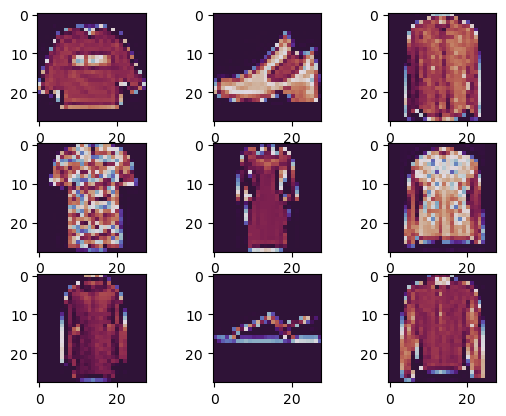

In [7]:
# Visualizamos nueve imagenes
fig, ax = plt.subplots(3,3)
f=0
c=0
for i in range(9):
    plt.subplot(330 + 1 + i)
    ax[f,c].imshow(np.reshape(fashion.drop("label", axis = 1).to_numpy(), (60000,28,28))[i], cmap=plt.get_cmap('twilight_shifted'))
    if c==2:
        f+=1
        c=0
    else:
        c+=1

plt.show()

### b) Divide las etiquetas de las imágenes y genera el conjunto de datos en train y test (50000 imágenes en train y 10000 en test).

In [8]:
# Dividimos el dataset en x e y
X = fashion.drop("label", axis = 1)
y = fashion["label"]

In [9]:
# Convertimos X a numpy array
X_array = X.to_numpy()

# Lo reescalamos para que en vez de tener dimension (1,784) tenga (28,28)
images = np.reshape(X_array, (60000,28,28))

In [10]:
# Dividimos en train y test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=50000/60000, random_state=1903)

In [11]:
# Comprobamos el tamaño
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(50000, 784) (10000, 784) (50000,) (10000,)


### c) Genera un modelo de red neuronal y calcula los resultados en train y test.

In [12]:
# Definimos el modelo
mlp = MLPClassifier(hidden_layer_sizes=(50,), max_iter=15, alpha=1e-4, solver="sgd", random_state=1903, learning_rate_init=0.1)

In [13]:
# Entrenamos el modelo
mlp.fit(X_train, y_train)

MLPClassifier(hidden_layer_sizes=(50,), learning_rate_init=0.1, max_iter=15,
              random_state=1903, solver='sgd')

In [14]:
# Predicción train
predict_train =  mlp.predict(X_train)

# Predicción test
predict_test = mlp.predict(X_test)

**ACCURACY**

In [15]:
# Train
acc_train = accuracy_score(predict_train, y_train)

# Test
acc_test = accuracy_score(predict_test, y_test)

In [16]:
print(f'TRAIN: {acc_train:.4f}\nTEST: {acc_test:.4f}')

TRAIN: 0.1004
TEST: 0.0982


**MATRIZ DE CONFUSIÓN**

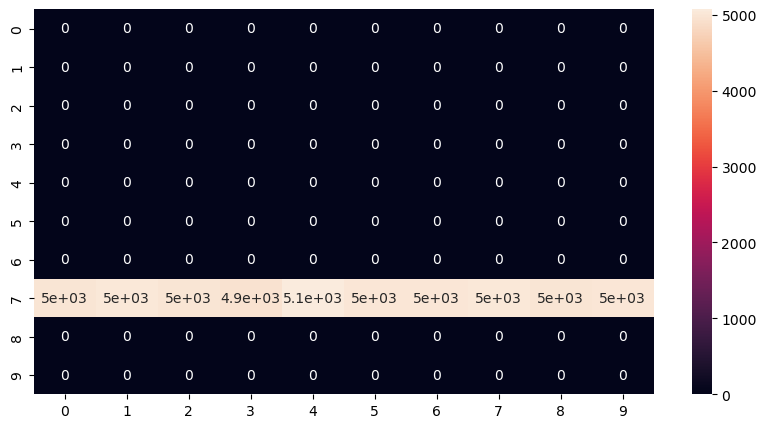

In [17]:
# Train
plt.figure(figsize=(10,5))
sns.heatmap(pd.DataFrame(confusion_matrix(predict_train, y_train), columns = range(0,10), index = range(0,10)), annot = True)
plt.show()

### d) Prueba a normalizar los datos y generar otro modelo. ¿Mejoran los resultados?

In [18]:
# Normalizamos X_train y X_test
X_train_norm = X_train / 255.
X_test_norm = X_test / 255.

In [19]:
# Entrenamos el mismo modelo
mlp.fit(X_train_norm, y_train)

MLPClassifier(hidden_layer_sizes=(50,), learning_rate_init=0.1, max_iter=15,
              random_state=1903, solver='sgd')

In [20]:
# Predicción train normalizado
predict_train_norm =  mlp.predict(X_train_norm)

# Predicción test normalizado
predict_test_norm = mlp.predict(X_test_norm)

### e) Calculas las métricas para este nuevo resultado.

**ACCURACY**

In [21]:
# Train
acc_train_norm = accuracy_score(predict_train_norm, y_train)

# Test
acc_test_norm = accuracy_score(predict_test_norm, y_test)

In [22]:
print(f'TRAIN: {acc_train_norm:.4f}\nTEST: {acc_test_norm:.4f}')

TRAIN: 0.9135
TEST: 0.8821


**MATRIZ DE CONFUSIÓN**

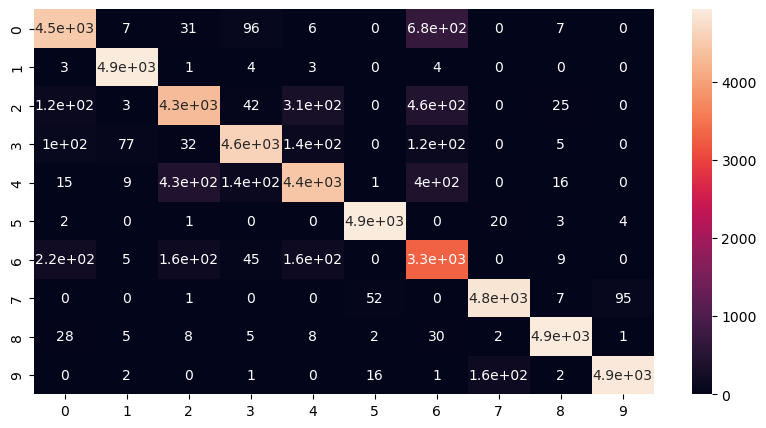

In [23]:
# Train
plt.figure(figsize=(10,5))
sns.heatmap(pd.DataFrame(confusion_matrix(predict_train_norm, y_train), columns = range(0,10), index = range(0,10)), annot = True)
plt.show()

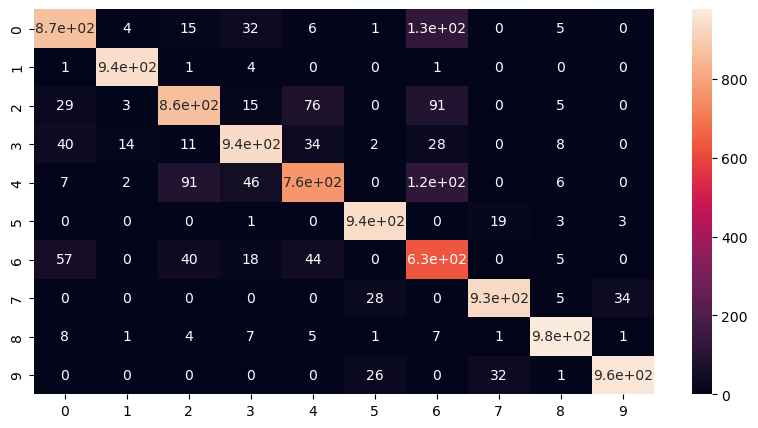

In [24]:
# Test
plt.figure(figsize=(10,5))
sns.heatmap(pd.DataFrame(confusion_matrix(predict_test_norm, y_test), columns = range(0,10), index = range(0,10)), annot = True)
plt.show()

### f) Implementa GridSearch para variar los hiperparámetros del modelo e intentar mejorar los resultados.

In [25]:
# # Definimos el conjunto de parametros
param_grid = {
    "hidden_layer_sizes":[50, 75, 100],
    "activation":["logistic","relu"],
    "solver":["adam", "sgd", "'lbfgs"],
    "max_iter":[15, 30, 45]
}

In [26]:
# Ejecutamos el GridSearch
gridsearch = GridSearchCV(MLPClassifier(random_state=1903), param_grid, cv = 5)

In [27]:
# Entrenamos el modelo
gridsearch.fit(X_train_norm, y_train)

GridSearchCV(cv=5, estimator=MLPClassifier(random_state=1903),
             param_grid={'activation': ['logistic', 'relu'],
                         'hidden_layer_sizes': [50, 75, 100],
                         'max_iter': [15, 30, 45],
                         'solver': ['adam', 'sgd', "'lbfgs"]})

In [28]:
# Vemos cual es el mejor estimador
gridsearch.best_estimator_

MLPClassifier(activation='logistic', hidden_layer_sizes=100, max_iter=45,
              random_state=1903)

In [29]:
# Prediccion sobre train 
predict_train_gs = gridsearch.best_estimator_.predict(X_train_norm)

# Prediccion sobre test
predict_test_gs = gridsearch.best_estimator_.predict(X_test_norm)

**ACCURACY**

In [30]:
# Train
acc_train_norm_gs = accuracy_score(predict_train_gs, y_train)

# Test
acc_test_norm_gs = accuracy_score(predict_test_gs, y_test)

In [31]:
print(f'TRAIN: {acc_train_norm_gs:.4f}\nTEST: {acc_test_norm_gs:.4f}')

TRAIN: 0.9353
TEST: 0.8949


**MATRIZ DE CONFUSIÓN**

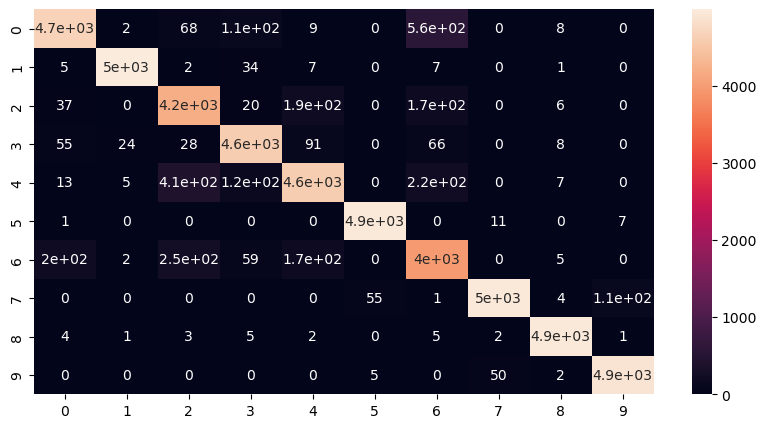

In [32]:
# Train
plt.figure(figsize=(10,5))
sns.heatmap(pd.DataFrame(confusion_matrix(predict_train_gs, y_train), columns = range(0,10), index = range(0,10)), annot = True)
plt.show()

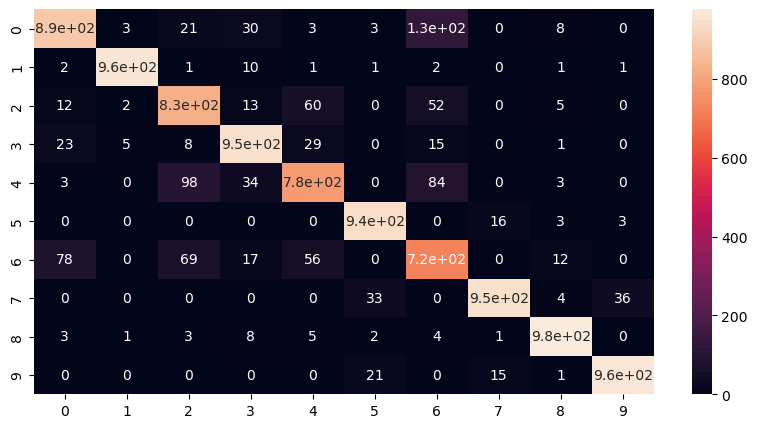

In [33]:
#Test
plt.figure(figsize=(10,5))
sns.heatmap(pd.DataFrame(confusion_matrix(predict_test_gs, y_test), columns = range(0,10), index = range(0,10)), annot = True)
plt.show()

## [EJERCICIO 4] Grafos

El dataset socialnet contiene información sobre las relaciones (y la intensidad de esas relaciones) en una red social. Estas relaciones pueden modelizarse como un grafo. A partir de este grafo, se quieren resolver las siguientes preguntas:

In [596]:
# Cargamos los datos
grafos = pd.read_csv("datasets/grafos.csv")

In [597]:
# Tamaño del dataset
grafos.shape

(51, 4)

In [598]:
# Visualizamos las primeras filas
grafos.head()

,from,to,weight,type
0,s01,s02,10,hyperlink
1,s01,s02,12,hyperlink
2,s01,s03,22,hyperlink
3,s01,s04,21,hyperlink
4,s04,s11,22,mention


In [599]:
# Vemos si hay nulos
grafos.isna().sum()

from      0
to        0
weight    0
type      0
dtype: int64

### a) Genera un grafo NO dirigido a partir del dataset de conexiones en la red social (from-to)

In [600]:
# Definimos el grafo
graph = nx.Graph()

***Equipo 1*** - *Para definir los vértices del grafo nos quedamos con todos los valores únicos de las columnas `from` y `to`.* 

In [601]:
# Nos quedamos con los valores unicos de cada columna
nodes_from = list(set(grafos['from']))
nodes_to = list(set(grafos['to']))

# Los juntamos y volvemos a quitar nulos
nodes = list(set(nodes_from + nodes_to))

In [602]:
# Definimos los vertices del grafo
graph.add_nodes_from(nodes)

***Equipo 1*** - *Para hacer los vértices, nos quedamos con una lista de sets entre las columnas `from` y `to`.*

In [603]:
# Creamos los vertices a partir del dataframe
edges = [(grafos.iloc[pos]['from'], grafos.iloc[pos]['to']) for pos in range(len(grafos))]

In [604]:
# Los añadimos al grafo
graph.add_edges_from(edges)

### b) ¿Cuántos nodos tiene el grafo?¿Cuántas aristas tiene el grafo?

In [605]:
# Número de nodos y vertices
n_nodes = graph.number_of_nodes()
n_edges = graph.number_of_edges()

In [606]:
print(f'Hay {n_nodes} nodos y {n_edges} aristas.')

Hay 17 nodos y 38 aristas.


### c) Visualiza el grafo resultante incluyendo las etiquetas de los nodos

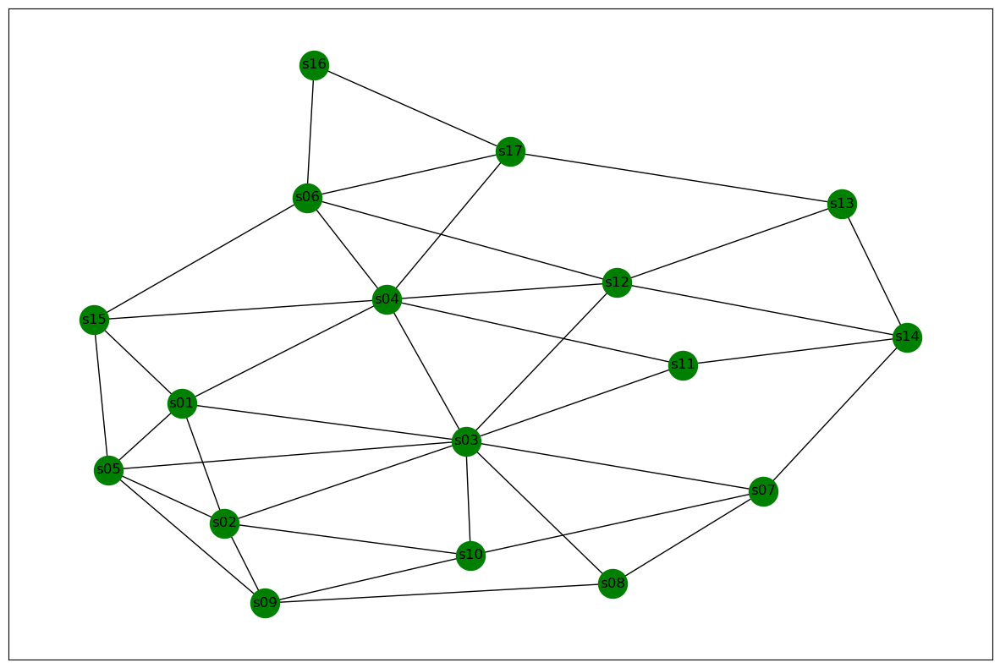

In [607]:
# Dibujamos el grafo
plt.figure(figsize=(15,10))
nx.draw_networkx(graph, with_labels=True, node_size=600, node_color='green')

### d) Añade el atributo de peso (weight) y el tipo de relación a cada arista (type) a las aristas del grafo.

In [608]:
# Creamos los vertices a partir del dataframe, incluyendo los atributos de peso y tipo
edges = [(grafos.iloc[pos]['from'], grafos.iloc[pos]['to'], {'weight': grafos.iloc[pos]['weight'],'type':grafos.iloc[pos]['type']}) for pos in range(len(grafos))]

In [609]:
# Los añadimos al grafo
graph.add_edges_from(edges)

### e) Visualiza ahora el grafo, marcando con un color distinto cada tipo de arista en función de type

In [610]:
# Definimos un código de colores para cada posible valor de la variable 'type'
color_code = ['blue' if t=='hyperlink' else 'red' for _,_,t in graph.edges(data='type')]

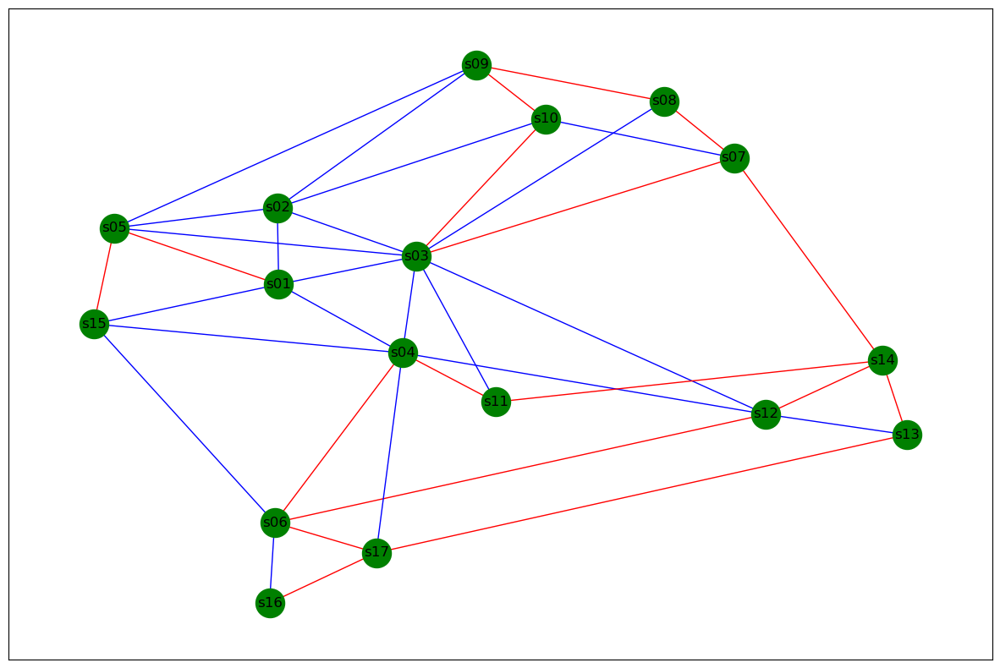

In [616]:
# Dibujamos el gráfico
plt.figure(figsize=(15,10))
nx.draw_networkx(graph, with_labels=True, node_size=600, node_color='green', edge_color=color_code)

### f) ¿Cuáles son los caminos entre el usuario s14 y el usuario s06 teniendo en cuenta únicamente 2 nodos de separación? (es decir, 3 aristas)

In [617]:
# Posibles caminos de s14 a s06 en 3 aristas
n = 1
possible_paths = list(nx.all_simple_paths(graph, 's14', 's06', 3)) 
for elem in possible_paths:
    print(f'CAMINO {n}: {elem}')
    n+=1

CAMINO 1: ['s14', 's12', 's04', 's06']
CAMINO 2: ['s14', 's12', 's06']
CAMINO 3: ['s14', 's13', 's12', 's06']
CAMINO 4: ['s14', 's13', 's17', 's06']
CAMINO 5: ['s14', 's11', 's04', 's06']


### g) A partir del algoritmo de Label Propagation, genera comunidades entre los distintos usuarios. Visualiza los resultados mostrando el grafo donde cada nodo debe llevar el color de la comunidad a la que pertenece. ¿Existen distintas comunidades o todos los usuarios pertenecen al mismo grupo?

In [618]:
# Generamos las distintas comunidades y las guardamos en una variable
communities = list(community.label_propagation_communities(graph)) 

In [619]:
# Comprobamos el número de comunidades
communities

[{'s01',
  's02',
  's03',
  's04',
  's05',
  's06',
  's07',
  's08',
  's09',
  's10',
  's11',
  's12',
  's13',
  's14',
  's15',
  's16',
  's17'}]

***Equipo 1*** - *Vemos que solo existe una comunidad. Vamos a hacer el desarrollo como si existiese más de una, aunque el grafo resultante será igual que el primero que vimos en este ejercicio. Este desarrollo será un diccionario donde cada clave es un nodo y el valor es la comunidad a la que pertenecen. Posteriormente asignamos un color a cada nodo y dibujamos el grafo resultante. Si tuviesemos más de una comunidad se verían los nodos de cada una de ellas de un color diferente.* 

In [620]:
# Asignamos un valor a cada nodo en función de la comunidad a la que pertenezca
node_color_map = {node:value for value, c in enumerate(communities) for node in c}

In [621]:
# Generamos una lista de colores para cada nodo
node_color = [node_color_map[n] for n in graph.nodes()]

In [622]:
node_color

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

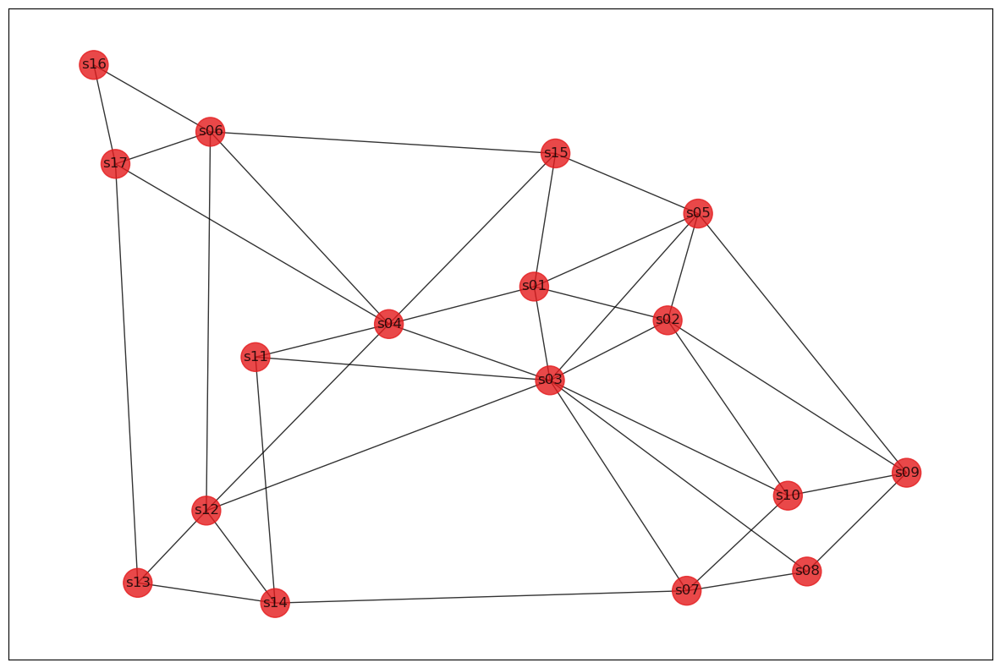

In [623]:
# Dibujamos el gráfico
plt.figure(figsize=(15,10))
nx.draw_networkx(graph, with_labels=True, node_size=600, node_color=node_color, cmap=plt.cm.Set1, alpha=0.8)

### h) ¿Existe conexión entre el usuario s16 y el usuario s11? Si es así, cuál es el camino más corto entre el usuario ambos usuarios?

***Equipo 1*** - *Como todo el grafo está conectado si que existirá camino entre el nodo s11 y el nodo s16. Vamos a ver cuál es el camino más corto y cuantos saltos habrá que dar.*

In [624]:
# Buscamos el camino más corto entre ambos grafos
graph_shortest_path = nx.shortest_path(graph,'s11', 's16')
graph_shortest_path_len = nx.shortest_path_length(graph,'s11', 's16')

print(f'El camino más corto entre los nodos s11 y s16 tiene {graph_shortest_path_len} saltos\nEl camino es: {graph_shortest_path}')

El camino más corto entre los nodos s11 y s16 tiene 3 saltos
El camino es: ['s11', 's04', 's17', 's16']


### i) ¿Cuáles son los caminos a recorrer desde el nodo s12 hasta el resto de nodos?

***Equipo 1*** - *Vamos a mostrar los caminos a recorrer desde el nodo s12 hacia los demás nodos basandonos en la mínima distancia posible a recorrer.*

In [625]:
# Creamos un diccionario que almacene, para cada nodo, el camino más corto a recorrer con el resto de nodos.
dict_paths = {}
for n in sorted(graph.nodes()):
    name = 's12 - ' + n
    dict_paths[name] = nx.shortest_path(graph,'s12', n)

dict_paths

{'s12 - s01': ['s12', 's03', 's01'],
 's12 - s02': ['s12', 's03', 's02'],
 's12 - s03': ['s12', 's03'],
 's12 - s04': ['s12', 's04'],
 's12 - s05': ['s12', 's03', 's05'],
 's12 - s06': ['s12', 's06'],
 's12 - s07': ['s12', 's14', 's07'],
 's12 - s08': ['s12', 's03', 's08'],
 's12 - s09': ['s12', 's03', 's08', 's09'],
 's12 - s10': ['s12', 's03', 's10'],
 's12 - s11': ['s12', 's04', 's11'],
 's12 - s12': ['s12'],
 's12 - s13': ['s12', 's13'],
 's12 - s14': ['s12', 's14'],
 's12 - s15': ['s12', 's06', 's15'],
 's12 - s16': ['s12', 's06', 's16'],
 's12 - s17': ['s12', 's06', 's17']}

### j) ¿Qué usuarios están directamente conectados al usuario s12? Visualiza el resultado.

***Equipo 1*** - *Vamos a reutilizar el diccionario anterior con la función shortest_path_length para ver la distancia entre el nodo s12 con los demas. Posteriormente filtramos el diccionario a aquellos nodos que tengan una distancia menor o igual a 1 (el unico caso con distancia 0 sera el propio nodo s12).*

In [626]:
# Creamos un diccionario que almacene, para cada nodo, la distancia más corta entre s12 y el resto de nodos.
dict_paths_len = {}
for n in sorted(graph.nodes()):
    name = 's12 - ' + n
    if nx.shortest_path_length(graph,'s12', n) <=1:
        dict_paths_len[name] = nx.shortest_path_length(graph,'s12', n)

dict_paths_len

{'s12 - s03': 1,
 's12 - s04': 1,
 's12 - s06': 1,
 's12 - s12': 0,
 's12 - s13': 1,
 's12 - s14': 1}

In [627]:
# Guardamos los nodos directamente conectados con s12
nodes_path = [keys[-3:] for keys in dict_paths_len if keys[-3:]!='s12']

# Generamos un código de colores en función de los nodos
color_code = ['green' if n in nodes_path else 'blue' if n=='s12' else 'grey' for n in graph.nodes()]

***Equipo 1*** - *Vamos a dibujar el grafo restante, el nodo 's12' se indica de color azul, los nodos directamente ocnectados en verde y lo que no están directamente conectados en gris.*

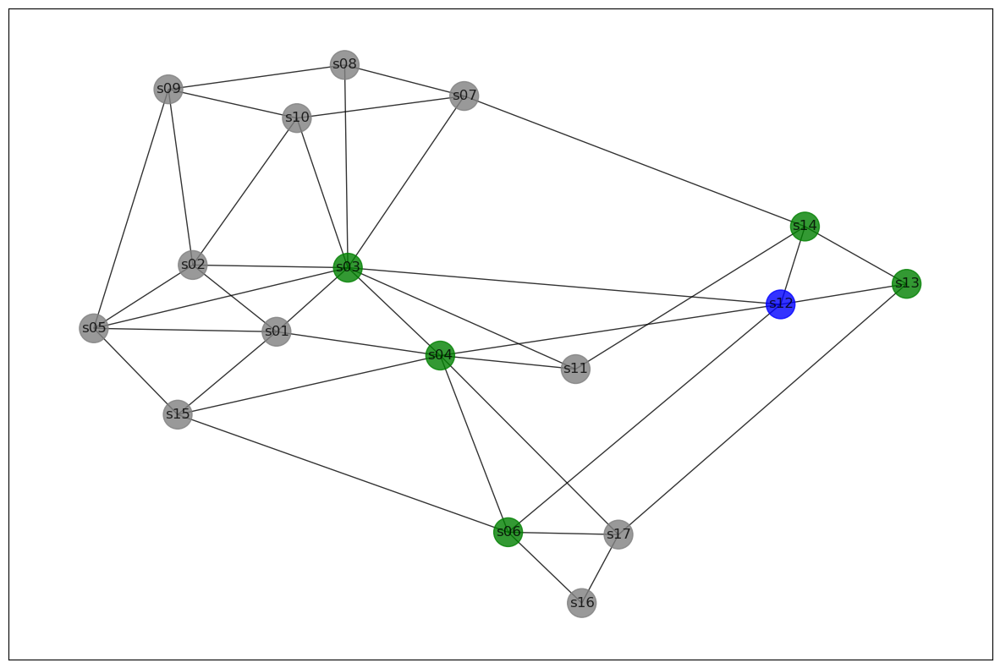

In [631]:
# Dibujamos el grafo restante
plt.figure(figsize=(15,10))
nx.draw_networkx(graph, with_labels=True, node_size=600, node_color=color_code, cmap=plt.cm.Set1, alpha=0.8)